In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Business case: FIFA Players
## Domain analysis:
- The dataset provided includes the players data for the Career Mode from FIFA 15 toFIFA 20. 
- The data allows multiple comparisons of the same players across the last 6 versions of the videogame.
- Expected job:
    - Task 1:-Prepare a complete data analysis report on the given data.
    - Task 2:- Explore football skills and cluster football players based on their attributes.
    - Task3:- Explore the data and attempt all the below asked questions in a step by step manner:
        - Prepare a rank ordered list of top 10 countries with most players. Which countries are producing the most footballers that play at this level?
        - Plot the distribution of overall rating vs. age of players. Interpret what is the age after which a player stops improving?
        - Which type of offensive players tends to get paid the most: the striker, the right-winger, or the left-winger?

## Data Acquisition - Basic Checks
- We observe the data, understand the data type, the distrubution of values of numerical columns, the statistics of all columns

In [2]:
raw_data = pd.read_csv('players_20.csv')

In [3]:
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)

In [4]:
raw_data.head()

,sofifa_id,player_url,short_name,long_name,age,dob,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,release_clause_eur,player_tags,team_position,team_jersey_number,loaned_from,joined,contract_valid_until,nation_position,nation_jersey_number,pace,shooting,passing,dribbling,defending,physic,gk_diving,gk_handling,gk_kicking,gk_reflexes,gk_speed,gk_positioning,player_traits,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,32,1987-06-24,170,72,Argentina,FC Barcelona,94,94,95500000,565000,"RW, CF, ST",Left,5,4,4,Medium/Low,Messi,Yes,195800000.0,"#Dribbler, #Distance Shooter, #Crosser, #FK Sp...",RW,10.0,NaN,2004-07-01,2021.0,NaN,NaN,87.0,92.0,92.0,96.0,39.0,66.0,NaN,NaN,NaN,NaN,NaN,NaN,"Beat Offside Trap, Argues with Officials, Earl...",88,95,70,92,88,97,93,94,92,96,91,84,93,95,95,86,68,75,68,94,48,40,94,94,75,96,33,37,26,6,11,15,14,8,89+2,89+2,89+2,93+2,93+2,93+2,93+2,93+2,93+2,93+2,93+2,92+2,87+2,87+2,87+2,92+2,68+2,66+2,66+2,66+2,68+2,63+2,52+2,52+2,52+2,63+2
1,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,34,1985-02-05,187,83,Portugal,Juventus,93,93,58500000,405000,"ST, LW",Right,5,4,5,High/Low,C. Ronaldo,Yes,96500000.0,"#Speedster, #Dribbler, #Distance Shooter, #Acr...",LW,7.0,NaN,2018-07-10,2022.0,LS,7.0,90.0,93.0,82.0,89.0,35.0,78.0,NaN,NaN,NaN,NaN,NaN,NaN,"Long Throw-in, Selfish, Argues with Officials,...",84,94,89,83,87,89,81,76,77,92,89,91,87,96,71,95,95,85,78,93,63,29,95,82,85,95,28,32,24,7,11,15,14,11,91+3,91+3,91+3,89+3,90+3,90+3,90+3,89+3,88+3,88+3,88+3,88+3,81+3,81+3,81+3,88+3,65+3,61+3,61+3,61+3,65+3,61+3,53+3,53+3,53+3,61+3
2,190871,https://sofifa.com/player/190871/neymar-da-sil...,Neymar Jr,Neymar da Silva Santos Junior,27,1992-02-05,175,68,Brazil,Paris Saint-Germain,92,92,105500000,290000,"LW, CAM",Right,5,5,5,High/Medium,Neymar,Yes,195200000.0,"#Speedster, #Dribbler, #Playmaker , #Crosser,...",CAM,10.0,NaN,2017-08-03,2022.0,LW,10.0,91.0,85.0,87.0,95.0,32.0,58.0,NaN,NaN,NaN,NaN,NaN,NaN,"Power Free-Kick, Injury Free, Selfish, Early C...",87,87,62,87,87,96,88,87,81,95,94,89,96,92,84,80,61,81,49,84,51,36,87,90,90,94,27,26,29,9,9,15,15,11,84+3,84+3,84+3,90+3,89+3,89+3,89+3,90+3,90+3,90+3,90+3,89+3,82+3,82+3,82+3,89+3,66+3,61+3,61+3,61+3,66+3,61+3,46+3,46+3,46+3,61+3
3,200389,https://sofifa.com/player/200389/jan-oblak/20/...,J. Oblak,Jan Oblak,26,1993-01-07,188,87,Slovenia,Atlético Madrid,91,93,77500000,125000,GK,Right,3,3,1,Medium/Medium,Normal,Yes,164700000.0,NaN,GK,13.0,NaN,2014-07-16,2023.0,GK,1.0,NaN,NaN,NaN,NaN,NaN,NaN,87.0,92.0,78.0,89.0,52.0,90.0,"Flair, Acrobatic Clearance",13,11,15,43,13,12,13,14,40,30,43,60,67,88,49,59,78,41,78,12,34,19,11,65,11,68,27,12,18,87,92,78,90,89,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,183277,https://sofifa.com/player/183277/eden-hazard/2...,E. Hazard,Eden Hazard,28,1991-01-07,175,74,Belgium,Real Madrid,91,91,90000000,470000,"LW, CF",Right,4,4,4,High/Medium,Normal,Yes,184500000.0,"#Speedster, #Dribbler, #Acrobat",LW,7.0,NaN,2019-07-01,

In [5]:
raw_data.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18278 entries, 0 to 18277
Data columns (total 104 columns):
 #    Column                      Dtype  
---   ------                      -----  
 0    sofifa_id                   int64  
 1    player_url                  object 
 2    short_name                  object 
 3    long_name                   object 
 4    age                         int64  
 5    dob                         object 
 6    height_cm                   int64  
 7    weight_kg                   int64  
 8    nationality                 object 
 9    club                        object 
 10   overall                     int64  
 11   potential                   int64  
 12   value_eur                   int64  
 13   wage_eur                    int64  
 14   player_positions            object 
 15   preferred_foot              object 
 16   international_reputation    int64  
 17   weak_foot                   int64  
 18   skill_moves                 int64  
 19   wo

In [6]:
raw_data.describe()

,sofifa_id,age,height_cm,weight_kg,overall,potential,value_eur,wage_eur,international_reputation,weak_foot,skill_moves,release_clause_eur,team_jersey_number,contract_valid_until,nation_jersey_number,pace,shooting,passing,dribbling,defending,physic,gk_diving,gk_handling,gk_kicking,gk_reflexes,gk_speed,gk_positioning,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes
count,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,1.827800e+04,18278.000000,18278.000000,18278.000000,18278.000000,1.698000e+04,18038.000000,18038.000000,1126.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,2036.000000,2036.000000,2036.000000,2036.000000,2036.000000,2036.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000,18278.000000
mean,219738.864482,25.283291,181.362184,75.276343,66.244994,71.546887,2.484038e+06,9456.942773,1.103184,2.944250,2.368038,4.740717e+06,20.103892,2021.114591,12.114565,67.700899,52.298301,57.233777,62.531585,51.553503,64.876678,65.422397,63.146365,61.832515,66.390472,37.798625,63.374754,49.718405,45.590218,52.221468,58.748003,42.809388,55.596509,47.325692,42.708885,52.768848,58.461976,64.299923,64.415746,63.504924,61.752544,63.856439,58.181694,64.928165,62.889485,65.234763,46.812945,55.742149,46.380239,50.072163,53.609749,48.383357,58.528778,46.848889,47.640333,45.606631,16.572765,16.354853,16.212934,16.368038,16.709924
std,27960.200461,4.656964,6.756961,7.047744,6.949953,6.139669,5.585481e+06,21351.714095,0.378861,0.664656,0.765038,1.103002e+07,16.603639,1.289888,6.735922,11.297656,14.029418,10.407844,10.284950,16.419528,9.760162,7.736278,7.244023,7.510709,8.154062,10.634038,8.447876,18.325403,19.594609,17.428429,14.679653,17.701815,18.929118,18.422991,17.433612,15.246454,16.741878,15.042232,14.847763,14.808380,9.135613,14.201559,13.326083,11.934059,16.017954,12.534811,19.322343,17.318157,20.775812,19.594022,13.955626,15.708099,11.880840,20.091287,21.585641,21.217734,17.738069,16.996925,16.613665,17.136497,18.038125
min,768.000000,16.000000,156.000000,50.000000,48.000000,49.000000,0.000000e+00,0.000000,1.000000,1.000000,1.000000,1.300000e+04,1.000000,2019.000000,1.000000,24.000000,15.000000,24.000000,23.000000,15.000000,27.000000,44.000000,42.000000,35.000000,45.000000,12.000000,41.000000,5.000000,2.000000,5.000000,7.000000,3.000000,4.000000,6.000000,4.000000,8.000000,5.000000,12.000000,11.000000,11.000000,21.000000,12.000000,14.000000,19.000000,12.000000,20.000000,4.000000,9.000000,3.000000,2.000000,9.000000,7.000000,12.000000,1.000000,5.000000,3.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,204445.500000,22.000000,177.000000,70.000000,62.000000,67.000000,3.250000e+05,1000.000000,1.000000,3.000000,2.000000,5.630000e+05,9.000000,2020.000000,6.000000,61.000000,42.000000,50.000000,57.000000,36.000000,59.000000,60.000000,58.000000,57.000000,60.750000,29.000000,58.000000,38.000000,30.000000,44.000000,54.000000,30.000000,50.000000,34.000000,31.000000,43.000000,54.000000,56.000000,57.

In [7]:
raw_data.describe(include='O')

,player_url,short_name,long_name,dob,nationality,club,player_positions,preferred_foot,work_rate,body_type,real_face,player_tags,team_position,loaned_from,joined,nation_position,player_traits,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
count,18278,18278,18278,18278,18278,18278,18278,18278,18278,18278,18278,1499,18038,1048,16990,1126,7566,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242
unique,18278,17354,18218,6142,162,698,643,2,9,10,2,83,29,316,1760,26,921,94,94,94,107,103,103,103,107,103,103,103,100,88,88,88,100,98,98,98,98,98,96,110,110,110,96
top,https://sofifa.com/player/158023/lionel-messi/...,J. Rodríguez,Liam Kelly,1992-02-29,England,FC Barcelona,CB,Right,Medium/Medium,Normal,No,#Strength,SUB,Sassuolo,2019-07-01,SUB,Early Crosser,61+2,61+2,61+2,63+2,63+2,63+2,63+2,63+2,61+2,61+2,61+2,61+2,58+2,58+2,58+2,61+2,59+2,59+2,59+2,59+2,59+2,61+2,63+2,63+2,63+2,61+2
freq,1,11,3,113,1667,33,2322,13960,9875,10750,16310,514,7820,17,1465,587,501,725,725,725,736,727,727,727,736,748,748,748,809,775,775,775,809,682,636,636,636,682,667,621,621,621,667


In [8]:
raw_data.isnull().sum()

sofifa_id                         0
player_url                        0
short_name                        0
long_name                         0
age                               0
dob                               0
height_cm                         0
weight_kg                         0
nationality                       0
club                              0
overall                           0
potential                         0
value_eur                         0
wage_eur                          0
player_positions                  0
preferred_foot                    0
international_reputation          0
weak_foot                         0
skill_moves                       0
work_rate                         0
body_type                         0
real_face                         0
release_clause_eur             1298
player_tags                   16779
team_position                   240
team_jersey_number              240
loaned_from                   17230
joined                      

## Feature Description:
- The attributes used in the project are:
    - sofifa_id: ID given by fifa to the player
    - player_url: url link of player
    - Long_name: Full name of the player.
    - short_Name: colloquial Name of the player.
    - Age: Age of the player.
    - dob: Date of birth of player
    - Height: Height of the player in cm.
    - Weight: Weight of the player
    - nationality: Nationality of the player
    - club: Club for which they play
    - Overall: General performance quality and value of the player representing the key positional skills and international reputation rated between 1-99. Overall attribute is used only in preprocessing and discussion stages because using it in modelling could lead to domination by this feature. The aim of the project is not basically sort and categorize the players using their overall talent and international reputation, but to cluster them based on using their whole skillset.
    - Potential: Maximum Overall rating expected to be reached by a player in the top of his career rated between 1-99.
    - val_eur: The total value of the player.
    - wage_eur: The monthly earning of the player.
    - Player_Position: The position in which the players can play. Position of the players on the pitch which determines their roles and responsibilities in the team. Forward positions in the football and FIFA 19 can be grouped as striker (ST: center striker, RS: right striker, LS: left striker), forward (CF: center forward, RF: right forward, LF: left forward) and winger (RW: right winger, LW: left winger). The word, forward, is used both as a general term and a special position. Strikers are positioned in front of forwards and wingers and very closed to the opposing goal. Their main responsibilities are attacking and scoring goals, that’s why their ball control, shooting and finishing skills are expected to be well. Center forwards are positioned right behind the strikers. They are expected to receive balls from the others and score assists to the others or goals. In addition to the skills expected from strikers, they have to be good at passing. Right forwards and left forwards are positioned at the right and left of the center forwards with the same expectations. Wingers are positioned near the touchlines to create chances for strikers and forwards from the right and left side of the field by breakthrough and crosses and to score goals. They are expected to be good at dribbling, acceleration, passing and crossing. Positions are used only in preprocessing and discussion stages.
        - ST: Positional skill. Player’s general ability when playing in ST position rated between 1-99.
        - RS: Positional skill. Player’s general ability when playing in in RS position rated between 1-99.
        - LS: Positional skill. Player’s general ability when playing in in LS position rated between 1-99.
        - CF: Positional skill. Player’s general ability when playing in in CF position rated between 1-99.
        - RF: Positional skill. Player’s general ability when playing in in RF position rated between 1-99.
        - LF: Positional skill. Player’s general ability when playing in in LF position rated between 1-99.
        - RW: Positional skill. Player’s general ability when playing in in RW position rated between 1-99.
        - LW: Positional skill. Player’s general ability when playing in in LW position rated between 1-99.
    - PreferredFoot: Right or Left. Label encoder is applied as 0 for left and 1 for right.
    - international_reputation: Rated between 1-5. 
    - WeakFoot: Represents how well a player uses his weak foot (e.g. left for righties) rated between 1 to 5.
    - skill_moves: How skilled a player is at moves. Rated from 1-5
    - WorkRate: Degree of the effort the player puts in terms of attack and defense rated as low, medium and high. This feature is divided into two new features as AttackWorkRate and DefenseWorkRate. Besides, label encoder is applied as 0 for low, 0.5 for medium and 1 for high.
    - bodytype: The body type of player
    - real face: whether the game had the player's real face or not
    - release_clause_eur: The number of euros to be paid to relase the player from bond
    - player tags: The tags or attributes the player is associated with.
    - team position: Position of player in team
    - team_jersey number: The jersey number of the player in the team
    - loaned from: The club from which the player loaned from
    - joined: The date of joining of player in club
    - contract valid until: year until the contract ends
    - national position: players position when playing for national team
    - nation_jersery number: Jersey number of player while playing for nation.
    - pace, shooting, passing, dribbling, defending, physic, gk_diving, gk_handling, gk_kicking, gk_reflexes, gk_speed, gk_positioning: Attributes of play, rated between 1 and 99.
    - player traits: stadium behavioral traits of the player
    - attacking_crossing: Crossing skill rated between 1-99.
    - attacking_finishing:Finishing skill of the player rated between 1-99
    - attacking_heading_accuracy:Player’s accuracy to pass or shoot by using his head rated between 1-99.
    - attacking_short_passing:Player’s accuracy for short passes rated between 1-99.
    - attacking_volleys: Player's capacity to throw volleys rated between 1-99
    - skill_dribbling: Dribbling skill of the player rated between 1-99.Dribbling is carrying the ball without losing while moving in one particular direction.
    - skill_curve: Skill improvement rate rated between 1-99
    - skill_fk_accuracy: Free kick goals capacity rated between 1-99
    - skill_long_passing: Long passig capacity rated between 1-99
    - skill_ball_control: Player’s ability to control the ball rated between 1-99.
    - movement_acceleration: Shows how fast a player can reach his maximum sprint speed rated between 1-99.
    - movement_sprint_speed: Speed rate of the player rated between 1-99.
    - movement_agility: Gracefulness and quickness of the player while controlling the ball rated between 1-99.
    - movement_reactions: Acting speed of the player to what happens in his environment rated between 1-99.
    - movement_balance: Player’s ability to remain steady while running, carrying and controlling the ball rated between 1-99.
    - power_shot_power: Player’s strength level of shooting the ball rated between 1- 99.
    - power_jumping: Player’s jumping skill rated between 1-99.
    - power_stamina:  Player’s ability to sustain his stamina level during the match rated between 1-99. Players with lower stamina get tired fast.
    - power_strength: Physical strength of the player rated between 1-99.
    - power_long_shots: Player’s accuracy of shoots from long distances rated between 1-99.
    - mentality_aggression: Aggression level of the player while pushing, pulling and tackling rated between 1-99.
    - mentality_interceptions: Player interception capacity rated between 1-99.
    - mentality_positioning: Player’s ability to place himself in the right position to receive the ball or score goals rated between 1-99.
    - mentality_vision: Player’s mental awareness about the other players in the team for passing rated between 1-99.
    - mentality_penalties: Player’s accuracy to score goals from penalty rated between 1-99.
    - mentality_composure: Player’s ability to control his calmness and frustration during the match rated between 1-99.
    - defending_marking: Player's ability to mark/manage defence rated between 1-99.
    - defending_standing_tackle: Player’s ability to perform tackle (take the ball from the opposite player) while standing rated between 1-99. It is a defensive skill.
    - defending_sliding_tackle:  Player’s ability to perform tackle by sliding rated between 1-99. It is a defensive skill.
    - goalkeeping_diving, goalkeeping_handling, goalkeeping_kicking, goalkeeping_positioning, goalkeeping_reflexes: Various skills of goal keeping rated between 1-99
    - Features ls-rb: Columns 78-103 are various attributes of player and related game, rated/scored from 1-99. The scores seemed to be 3 added to the scores. 

## Observations - Data Cleaning
- Player url, short_name and long names(there are multiple players with same short name or long name, but different actual names), real_face(game attribute), date of birth(age is sufficient) are completely unnecessary details
- overall rating is also not necessary, as it'll influence results
- we'll drop the sofifa_id as row numbers will serve as identifier of the players
- We'll create a new data frame with necessary details and drop unnecessary columns.
- Some columns namely, gk_diving,gk_handling,gk_kicking,gk_reflexes,gk_speed,gk_positioning,player tag, loaned from, national position number, national jersey number have more than 90% null values. Such data, even if replaced with a central value, still will largely bias the clustering. These columns shall be eliminated.
- Column 'player_traits' has 60% of null values. This column shall also be dropped.
- Other columns with null values also needs to be adjusted.

In [9]:
data = raw_data.drop(['long_name','player_url','short_name','real_face','dob','sofifa_id','loaned_from', 'nation_position','nation_jersey_number', 'player_tags', 'gk_diving', 'gk_handling', 'gk_kicking','gk_reflexes', 'gk_speed', 'gk_positioning','player_traits'],axis=1)
data.head()

,age,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,release_clause_eur,team_position,team_jersey_number,joined,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,32,170,72,Argentina,FC Barcelona,94,94,95500000,565000,"RW, CF, ST",Left,5,4,4,Medium/Low,Messi,195800000.0,RW,10.0,2004-07-01,2021.0,87.0,92.0,92.0,96.0,39.0,66.0,88,95,70,92,88,97,93,94,92,96,91,84,93,95,95,86,68,75,68,94,48,40,94,94,75,96,33,37,26,6,11,15,14,8,89+2,89+2,89+2,93+2,93+2,93+2,93+2,93+2,93+2,93+2,93+2,92+2,87+2,87+2,87+2,92+2,68+2,66+2,66+2,66+2,68+2,63+2,52+2,52+2,52+2,63+2
1,34,187,83,Portugal,Juventus,93,93,58500000,405000,"ST, LW",Right,5,4,5,High/Low,C. Ronaldo,96500000.0,LW,7.0,2018-07-10,2022.0,90.0,93.0,82.0,89.0,35.0,78.0,84,94,89,83,87,89,81,76,77,92,89,91,87,96,71,95,95,85,78,93,63,29,95,82,85,95,28,32,24,7,11,15,14,11,91+3,91+3,91+3,89+3,90+3,90+3,90+3,89+3,88+3,88+3,88+3,88+3,81+3,81+3,81+3,88+3,65+3,61+3,61+3,61+3,65+3,61+3,53+3,53+3,53+3,61+3
2,27,175,68,Brazil,Paris Saint-Germain,92,92,105500000,290000,"LW, CAM",Right,5,5,5,High/Medium,Neymar,195200000.0,CAM,10.0,2017-08-03,2022.0,91.0,85.0,87.0,95.0,32.0,58.0,87,87,62,87,87,96,88,87,81,95,94,89,96,92,84,80,61,81,49,84,51,36,87,90,90,94,27,26,29,9,9,15,15,11,84+3,84+3,84+3,90+3,89+3,89+3,89+3,90+3,90+3,90+3,90+3,89+3,82+3,82+3,82+3,89+3,66+3,61+3,61+3,61+3,66+3,61+3,46+3,46+3,46+3,61+3
3,26,188,87,Slovenia,Atlético Madrid,91,93,77500000,125000,GK,Right,3,3,1,Medium/Medium,Normal,164700000.0,GK,13.0,2014-07-16,2023.0,NaN,NaN,NaN,NaN,NaN,NaN,13,11,15,43,13,12,13,14,40,30,43,60,67,88,49,59,78,41,78,12,34,19,11,65,11,68,27,12,18,87,92,78,90,89,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,28,175,74,Belgium,Real Madrid,91,91,90000000,470000,"LW, CF",Right,4,4,4,High/Medium,Normal,184500000.0,LW,7.0,2019-07-01,2024.0,91.0,83.0,86.0,94.0,35.0,66.0,81,84,61,89,83,95,83,79,83,94,94,88,95,90,94,82,56,84,63,80,54,41,87,89,88,91,34,27,22,11,12,6,8,8,83+3,83+3,83+3,89+3,88+3,88+3,88+3,89+3,89+3,89+3,89+3,89+3,83+3,83+3,83+3,89+3,66+3,63+3,63+3,63+3,66+3,61+3,49+3,49+3,49+3,61+3


In [10]:
data.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18278 entries, 0 to 18277
Data columns (total 87 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   age                         18278 non-null  int64  
 1   height_cm                   18278 non-null  int64  
 2   weight_kg                   18278 non-null  int64  
 3   nationality                 18278 non-null  object 
 4   club                        18278 non-null  object 
 5   overall                     18278 non-null  int64  
 6   potential                   18278 non-null  int64  
 7   value_eur                   18278 non-null  int64  
 8   wage_eur                    18278 non-null  int64  
 9   player_positions            18278 non-null  object 
 10  preferred_foot              18278 non-null  object 
 11  international_reputation    18278 non-null  int64  
 12  weak_foot                   18278 non-null  int64  
 13  skill_moves                 182

In [11]:
data.columns

Index(['age', 'height_cm', 'weight_kg', 'nationality', 'club', 'overall',
       'potential', 'value_eur', 'wage_eur', 'player_positions',
       'preferred_foot', 'international_reputation', 'weak_foot',
       'skill_moves', 'work_rate', 'body_type', 'release_clause_eur',
       'team_position', 'team_jersey_number', 'joined', 'contract_valid_until',
       'pace', 'shooting', 'passing', 'dribbling', 'defending', 'physic',
       'attacking_crossing', 'attacking_finishing',
       'attacking_heading_accuracy', 'attacking_short_passing',
       'attacking_volleys', 'skill_dribbling', 'skill_curve',
       'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control',
       'movement_acceleration', 'movement_sprint_speed', 'movement_agility',
       'movement_reactions', 'movement_balance', 'power_shot_power',
       'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots',
       'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'menta

## Data Imputing
- Now we have to fix those columns which have null values
- These are the list of null_columns: 'release_clause_eur','player_tags','team_position','team_jersey_number', 'loaned_from','joined','contract_valid_until','nation_position','nation_jersey_number','pace','shooting', 'passing','dribbling','defending','physic','ls','st','rs','lw','lf','cf','rf','rw','lam','cam','ram','lm', 'lcm','cm','rcm','rm','lwb','ldm','cdm','rdm','rwb','lb','lcb','cb','rcb','rb'
- Of these there are a set of columns that have same number of null values. Lets inspect them.

In [12]:
data.loc[data.pace.isnull()]

,age,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,release_clause_eur,team_position,team_jersey_number,joined,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
3,26,188,87,Slovenia,Atlético Madrid,91,93,77500000,125000,GK,Right,3,3,1,Medium/Medium,Normal,164700000.0,GK,13.0,2014-07-16,2023.0,NaN,NaN,NaN,NaN,NaN,NaN,13,11,15,43,13,12,13,14,40,30,43,60,67,88,49,59,78,41,78,12,34,19,11,65,11,68,27,12,18,87,92,78,90,89,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,27,187,85,Germany,FC Barcelona,90,93,67500000,250000,GK,Right,3,4,1,Medium/Medium,Normal,143400000.0,GK,1.0,2014-07-01,2022.0,NaN,NaN,NaN,NaN,NaN,NaN,18,14,11,61,14,21,18,12,63,30,38,50,37,86,43,66,79,35,78,10,43,22,11,70,25,70,25,13,10,88,85,88,88,90,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
13,26,191,91,Brazil,Liverpool,89,91,58000000,155000,GK,Right,3,3,1,Medium/Medium,Normal,111700000.0,GK,1.0,2018-07-19,2024.0,NaN,NaN,NaN,NaN,NaN,NaN,17,13,19,45,20,27,19,18,44,30,56,47,40,88,37,64,52,32,78,14,27,11,13,66,23,65,15,19,16,85,84,85,90,89,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14,28,192,82,Spain,Manchester United,89,90,56000000,205000,GK,Right,4,3,1,Medium/Medium,Lean,110600000.0,GK,1.0,2011-07-01,2020.0,NaN,NaN,NaN,NaN,NaN,NaN,17,13,21,50,13,18,21,19,47,38,57,58,63,87,43,61,67,43,60,12,38,30,12,65,29,68,25,21,13,90,84,81,85,92,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25,25,188,86,Brazil,Manchester City,88,91,54500000,185000,GK,Left,2,3,1,Medium/Medium,Normal,104900000.0,GK,31.0,2017-07-01,2024.0,NaN,NaN,NaN,NaN,NaN,NaN,20,14,14,56,18,23,15,20,58,40,64,63,60,87,48,70,66,41,68,18,38,27,20,70,17,70,29,15,8,86,82,93,86,88,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
28,27,199,96,Belgium,Real Madrid,88,89,48000000,235000,GK,Left,4,2,1,Medium/Medium,Courtois,102000000.0,GK,13.0,2018-08-09,2024.0,NaN,NaN,NaN,NaN,NaN,NaN,14,14,13,33,12,13,19,20,35,23,46,52,61,83,45,54,68,38,70,17,23,15,13,44,27,66,20,18,16,85,89,72,85,87,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
30,34,193,92,Slovenia,Inter,88,88,26000000,110000,GK,Right,3,2,1,Medium/Medium,Normal,44200000.0,GK,1.0,2012-07-01,2021.0,NaN,NaN,NaN,NaN,NaN,NaN,12,10,10,36,12,12,12,14,34,16,51,55,47,83,36,52,78,41,71,19,25,22,12,41,23,69,25,10,13,88,85,69,89,89,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31,33,193,92,Germany,FC Bayern München,88,88,32000000,155000,GK,Right,5,4,1,Medium/Medium,Normal,52800000.0,GK,1.0,2011-07-01,2021.0,NaN,NaN,NaN,NaN,NaN,NaN,15,13,25,55,11,30,14,11,59,46,54,60,51,84,35,68,77,43,80,16,29,30,12,70,47,70,17,10,11,87,87,91,85,87,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
32,32,188,82,France,Tottenham Hotspur,88,88,36000000,150000,GK,Left,

- It is evident that, there are 2036 rows, which uniformly have the same 32 columnsn out of 87 columns as null values. 
- Leaving the basic features that contribute to the first 15 columns, the remaining features talk about the gaming capabilities of the players. 
- Out of these 70+ features, having 32 as imputed values (incase we choose to impute), might heavily impact the clustering, as these features will have same values in the 2036 columns. 
- So, these rows shall be dropped off from the data.

In [13]:
data.drop(data.loc[data.pace.isnull()].index,axis=0,inplace=True)

In [14]:
data.isnull().sum()

age                              0
height_cm                        0
weight_kg                        0
nationality                      0
club                             0
overall                          0
potential                        0
value_eur                        0
wage_eur                         0
player_positions                 0
preferred_foot                   0
international_reputation         0
weak_foot                        0
skill_moves                      0
work_rate                        0
body_type                        0
release_clause_eur            1165
team_position                  200
team_jersey_number             200
joined                        1155
contract_valid_until           200
pace                             0
shooting                         0
passing                          0
dribbling                        0
defending                        0
physic                           0
attacking_crossing               0
attacking_finishing 

- So we only have five columns that need cleaning.
- We'll proceed to process them and impute null values.
- Null columnns are: release_clause_eur (float), team_position (object), team_jersey_number (float), joined (object), contract_valid_until (float)
- We have to change the datatypes first, to understand their distribution and then impute null values

In [15]:
data['joined'] = pd.to_datetime(data['joined'])

<AxesSubplot:xlabel='joined', ylabel='Count'>

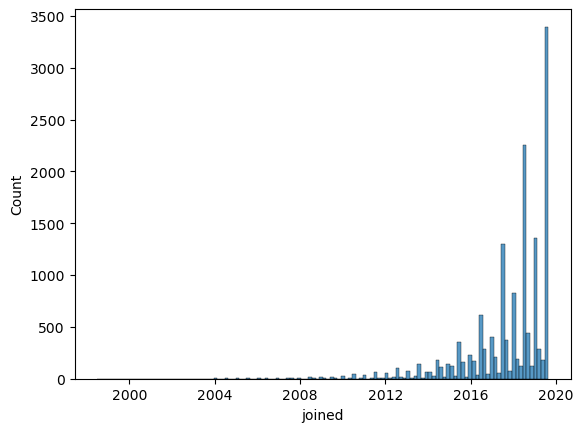

In [16]:
sns.histplot(data.joined)

- The histplot reveals that most players have joined towards 2017-2019. So, we'll replace the null values with mode of the values in the joined column.

In [17]:
data.joined.value_counts()

2019-07-01    1319
2018-07-01    1064
2017-07-01     648
2016-07-01     378
2018-01-01     235
2019-01-01     229
2015-07-01     225
2019-07-03     141
2019-07-08     138
2014-07-01     136
2017-01-01     127
2016-01-01     107
2015-01-01      98
2019-01-31      97
2019-07-24      96
2018-07-02      94
2013-07-01      91
2018-01-31      73
2012-07-01      72
2019-07-04      69
2019-07-02      68
2019-08-01      67
2018-08-31      67
2015-02-01      66
2019-07-05      63
2019-07-09      62
2019-02-01      62
2019-07-23      61
2019-07-15      60
2019-08-08      58
2019-07-19      57
2019-01-30      56
2016-02-01      55
2019-02-13      54
2014-01-01      54
2019-07-18      53
2019-07-30      52
2011-07-01      51
2018-07-23      50
2017-08-31      49
2019-07-25      49
2019-07-12      48
2019-08-02      48
2019-01-05      48
2018-08-09      47
2019-01-21      46
2019-07-10      45
2019-07-31      45
2019-07-11      45
2019-07-17      44
2012-01-01      44
2010-07-01      42
2019-01-04  

In [18]:
data.joined.value_counts().index[0]

Timestamp('2019-07-01 00:00:00')

In [19]:
data.loc[data.joined.isnull(),'joined'] = data.joined.value_counts().index[0]

In [20]:
data.joined.isnull().sum() #All null values are imputed.

0

In [21]:
#Since we cannot pass datetime inputs to clustering algorithms, we need to convert them into integer timestamp
# We divide it by 24*60*60*10**9 to get number of days. 
data.joined = (data.joined.astype('int')/(24*60*60*(10**9))).astype(int)

In [22]:
data.joined.head()

0    12600
1    17722
2    17381
4    18078
5    16677
Name: joined, dtype: int64

In [23]:
data.contract_valid_until.value_counts().index

Float64Index([2020.0, 2021.0, 2022.0, 2023.0, 2019.0, 2024.0, 2025.0, 2026.0], dtype='float64')

- Though the datatype of 'contract_valid_until' is float, we still cannot count it as float, as they're actually years. So,we'll impute the missing values with mode and then convert it into datetime variable.

In [24]:
data.loc[data.contract_valid_until.isnull(),'contract_valid_until'] = data.contract_valid_until.value_counts().index[0]

In [25]:
data.contract_valid_until.isnull().sum()

0

In [26]:
data.contract_valid_until = data.contract_valid_until.astype('int')

In [27]:
data.contract_valid_until.head()

0    2021
1    2022
2    2022
4    2024
5    2023
Name: contract_valid_until, dtype: int64

- We'll impute null values of team position now

In [28]:
data.team_position.value_counts()

SUB    6892
RES    2552
RCB     660
LCB     660
RB      560
LB      560
ST      458
LCM     411
RCM     411
RM      399
LM      398
CAM     311
RDM     244
LDM     242
RS      195
LS      195
CDM     181
LW      162
RW      161
CB      100
CM       76
RWB      58
LWB      58
RAM      23
LAM      23
RF       19
LF       19
CF       14
Name: team_position, dtype: int64

In [29]:
data.loc[data.team_position.isnull(),'team_position'] = data.team_position.value_counts().index[0]

- team_jersey_number is a float datatype. But in reality, the values are not continuous, though they are numbers. They need to be treated as object type only.
- We'll replace the null values with mode

In [30]:
data.team_jersey_number.value_counts()

7.0     599
8.0     595
11.0    581
10.0    581
5.0     580
9.0     577
6.0     565
4.0     552
17.0    530
19.0    527
14.0    526
3.0     526
20.0    519
2.0     499
23.0    490
18.0    487
15.0    481
21.0    442
22.0    436
16.0    419
27.0    401
24.0    391
25.0    355
26.0    353
29.0    337
28.0    318
13.0    292
33.0    260
30.0    238
12.0    223
32.0    218
31.0    215
34.0    173
35.0    151
36.0    137
37.0    128
39.0    103
38.0     94
44.0     87
77.0     81
40.0     78
42.0     61
99.0     56
45.0     54
41.0     52
88.0     49
43.0     36
46.0     32
70.0     32
55.0     31
50.0     31
47.0     29
49.0     24
66.0     23
92.0     19
80.0     19
98.0     18
90.0     18
48.0     17
91.0     17
87.0     16
97.0     14
56.0     14
71.0     13
93.0     12
95.0     12
89.0     11
94.0     11
67.0     10
51.0      9
52.0      9
54.0      9
78.0      9
96.0      8
57.0      8
73.0      8
59.0      8
72.0      7
76.0      7
53.0      7
60.0      7
61.0      7
58.0      6
63.0

In [31]:
data.loc[data.team_jersey_number.isnull(),'team_jersey_number'] = data.team_jersey_number.value_counts().index[0]

In [32]:
data.team_jersey_number = data.team_jersey_number.astype('int')

- Release clause is amount in euros, is the float value. And, let us look at the distribution of it, and based on it, we'll impute the null values with mean or median. 
- If the distribution is normal symmetric, we'll impute with mean, if not, we'll impute with median.

<AxesSubplot:xlabel='release_clause_eur', ylabel='Count'>

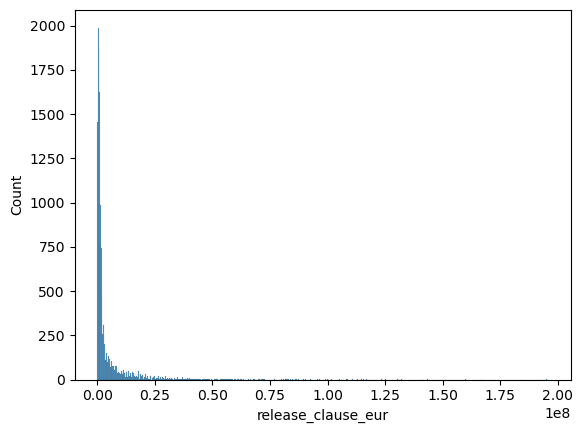

In [33]:
sns.histplot(data.release_clause_eur)

- Since the distribution is skewed, we'll impute the missing values with median

In [34]:
data.release_clause_eur.median()

1300000.0

In [35]:
data.loc[data.release_clause_eur.isnull(),'release_clause_eur'] = data.release_clause_eur.median()

In [36]:
data.release_clause_eur.median()

1300000.0

### Datatype transformation - Encoding 
- All the null values are addressed, and we'll proceed towards clustering
- Some data types need to be changed, as they are inappropriately given
- For instance, from columns 72-97, they seem to be mathematical expressions, but were in object format. We should evaluate them and put them in the column into int datatype

In [37]:
data.reset_index(drop=True,inplace=True)

In [38]:
data.head()

,age,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,release_clause_eur,team_position,team_jersey_number,joined,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,32,170,72,Argentina,FC Barcelona,94,94,95500000,565000,"RW, CF, ST",Left,5,4,4,Medium/Low,Messi,195800000.0,RW,10,12600,2021,87.0,92.0,92.0,96.0,39.0,66.0,88,95,70,92,88,97,93,94,92,96,91,84,93,95,95,86,68,75,68,94,48,40,94,94,75,96,33,37,26,6,11,15,14,8,89+2,89+2,89+2,93+2,93+2,93+2,93+2,93+2,93+2,93+2,93+2,92+2,87+2,87+2,87+2,92+2,68+2,66+2,66+2,66+2,68+2,63+2,52+2,52+2,52+2,63+2
1,34,187,83,Portugal,Juventus,93,93,58500000,405000,"ST, LW",Right,5,4,5,High/Low,C. Ronaldo,96500000.0,LW,7,17722,2022,90.0,93.0,82.0,89.0,35.0,78.0,84,94,89,83,87,89,81,76,77,92,89,91,87,96,71,95,95,85,78,93,63,29,95,82,85,95,28,32,24,7,11,15,14,11,91+3,91+3,91+3,89+3,90+3,90+3,90+3,89+3,88+3,88+3,88+3,88+3,81+3,81+3,81+3,88+3,65+3,61+3,61+3,61+3,65+3,61+3,53+3,53+3,53+3,61+3
2,27,175,68,Brazil,Paris Saint-Germain,92,92,105500000,290000,"LW, CAM",Right,5,5,5,High/Medium,Neymar,195200000.0,CAM,10,17381,2022,91.0,85.0,87.0,95.0,32.0,58.0,87,87,62,87,87,96,88,87,81,95,94,89,96,92,84,80,61,81,49,84,51,36,87,90,90,94,27,26,29,9,9,15,15,11,84+3,84+3,84+3,90+3,89+3,89+3,89+3,90+3,90+3,90+3,90+3,89+3,82+3,82+3,82+3,89+3,66+3,61+3,61+3,61+3,66+3,61+3,46+3,46+3,46+3,61+3
3,28,175,74,Belgium,Real Madrid,91,91,90000000,470000,"LW, CF",Right,4,4,4,High/Medium,Normal,184500000.0,LW,7,18078,2024,91.0,83.0,86.0,94.0,35.0,66.0,81,84,61,89,83,95,83,79,83,94,94,88,95,90,94,82,56,84,63,80,54,41,87,89,88,91,34,27,22,11,12,6,8,8,83+3,83+3,83+3,89+3,88+3,88+3,88+3,89+3,89+3,89+3,89+3,89+3,83+3,83+3,83+3,89+3,66+3,63+3,63+3,63+3,66+3,61+3,49+3,49+3,49+3,61+3
4,28,181,70,Belgium,Manchester City,91,91,90000000,370000,"CAM, CM",Right,4,5,4,High/High,Normal,166500000.0,RCM,17,16677,2023,76.0,86.0,92.0,86.0,61.0,78.0,93,82,55,92,82,86,85,83,91,91,77,76,78,91,76,91,63,89,74,90,76,61,88,94,79,91,68,58,51,15,13,5,10,13,82+3,82+3,82+3,87+3,87+3,87+3,87+3,87+3,88+3,88+3,88+3,88+3,87+3,87+3,87+3,88+3,77+3,77+3,77+3,77+3,77+3,73+3,66+3,66+3,66+3,73+3


In [39]:
data.describe()

,age,height_cm,weight_kg,overall,potential,value_eur,wage_eur,international_reputation,weak_foot,skill_moves,release_clause_eur,team_jersey_number,joined,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes
count,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,1.624200e+04,16242.000000,16242.000000,16242.000000,16242.000000,1.624200e+04,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000,16242.000000
mean,25.160017,180.475249,74.438493,66.426548,71.729528,2.578808e+06,9806.550917,1.105036,3.002647,2.539527,4.664722e+06,19.820219,17483.658540,2021.112363,67.700899,52.298301,57.233777,62.531585,51.553503,64.876678,54.180766,49.851188,56.995382,62.728543,46.674116,60.856360,51.434491,46.282478,56.136929,63.322189,67.635821,67.742950,66.478759,62.152198,66.520256,59.644994,65.876986,66.993720,65.830378,51.147149,59.475988,50.121229,54.989780,55.558490,51.998338,60.460781,50.879571,51.863995,49.590445,10.449267,10.489349,10.494336,10.475557,10.482268
std,4.544366,6.454725,6.692058,6.842286,6.081446,5.650534e+06,21828.924637,0.380939,0.638101,0.628193,1.077590e+07,16.107707,748.234821,1.289840,11.297656,14.029418,10.407844,10.284950,16.419528,9.760162,14.044269,16.340531,11.638265,9.619125,14.700085,12.346669,15.094479,14.994287,12.301053,9.952176,11.800788,11.548859,12.281811,8.807388,12.174540,13.290262,11.627546,11.404695,12.568418,15.782163,14.326789,18.856113,14.582565,12.819629,12.437148,10.212126,17.443311,19.047749,19.046176,3.151987,3.107684,3.153835,3.131174,3.103845
min,16.000000,156.000000,50.000000,48.000000,49.000000,0.000000e+00,0.000000,1.000000,1.000000,2.000000,1.800000e+04,2.000000,10408.000000,2019.000000,24.000000,15.000000,24.000000,23.000000,15.000000,27.000000,11.000000,10.000000,12.000000,23.000000,10.000000,16.000000,11.000000,10.000000,19.000000,24.000000,20.000000,25.000000,23.000000,31.000000,22.000000,14.000000,25.000000,29.000000,20.000000,11.000000,10.000000,10.000000,11.000000,12.000000,11.000000,27.000000,10.000000,10.000000,10.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,21.000000,176.000000,70.000000,62.000000,67.000000,3.500000e+05,1000.000000,1.000000,3.000000,2.000000,6.480000e+05,8.000000,17226.000000,2020.000000,61.000000,42.000000,50.000000,57.000000,36.000000,59.000000,44.000000,36.000000,49.000000,57.000000,35.000000,55.000000,40.000000,34.000000,48.000000,58.000000,61.000000,62.000000,59.000000,56.000000,60.000000,51.000000,59.000000,60.000000,58.000000,39.000000,50.000000,33.000000,47.000000,47.000000,42.000000,53.000000,36.000000,35.000000,32.000000,8.000000,8.000000,8.000000,8.000000,8.000000
50%,25.000000,180.000000,74.000000,66.000000,71.000000,7.500000e+05,3000.000000,1.000000,3.000000,2.000000,1.300000e+06,17.000000,17713.000000,2021.000000,69.000000,54.000000,58.000000,64.000000,56.000000,66.000000,56

In [40]:
data.describe(include='O')

,nationality,club,player_positions,preferred_foot,work_rate,body_type,team_position,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
count,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242,16242
unique,161,696,642,2,9,9,28,94,94,94,107,103,103,103,107,103,103,103,100,88,88,88,100,98,98,98,98,98,96,110,110,110,96
top,England,FC Barcelona,CB,Right,Medium/Medium,Normal,SUB,61+2,61+2,61+2,63+2,63+2,63+2,63+2,63+2,61+2,61+2,61+2,61+2,58+2,58+2,58+2,61+2,59+2,59+2,59+2,59+2,59+2,61+2,63+2,63+2,63+2,61+2
freq,1497,30,2322,12144,7839,9293,7092,725,725,725,736,727,727,727,736,748,748,748,809,775,775,775,809,682,636,636,636,682,667,621,621,621,667


In [41]:
for i in data.columns[1:]:
    print('Column name: ',i,'\n No. of unique values: ',len(data[i].unique()))
    #print('Value counts of variables: \n',data[i].value_counts())

Column name:  height_cm 
 No. of unique values:  47
Column name:  weight_kg 
 No. of unique values:  52
Column name:  nationality 
 No. of unique values:  161
Column name:  club 
 No. of unique values:  696
Column name:  overall 
 No. of unique values:  47
Column name:  potential 
 No. of unique values:  47
Column name:  value_eur 
 No. of unique values:  211
Column name:  wage_eur 
 No. of unique values:  141
Column name:  player_positions 
 No. of unique values:  642
Column name:  preferred_foot 
 No. of unique values:  2
Column name:  international_reputation 
 No. of unique values:  5
Column name:  weak_foot 
 No. of unique values:  5
Column name:  skill_moves 
 No. of unique values:  4
Column name:  work_rate 
 No. of unique values:  9
Column name:  body_type 
 No. of unique values:  9
Column name:  release_clause_eur 
 No. of unique values:  1155
Column name:  team_position 
 No. of unique values:  28
Column name:  team_jersey_number 
 No. of unique values:  98
Column name:  join

- Columns 61 onwards, are mathematical expressions, that need to be evaluated. We do it using lambda function.

In [42]:
data.columns[61:]

Index(['ls', 'st', 'rs', 'lw', 'lf', 'cf', 'rf', 'rw', 'lam', 'cam', 'ram',
       'lm', 'lcm', 'cm', 'rcm', 'rm', 'lwb', 'ldm', 'cdm', 'rdm', 'rwb', 'lb',
       'lcb', 'cb', 'rcb', 'rb'],
      dtype='object')

In [43]:
len(data['ls'])

16242

In [44]:
for i in data.columns[61:]:
    data[i] = data.apply(lambda x: eval(x[i]),axis=1)

In [45]:
data[data.columns[61:]].head()

,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,91,91,91,95,95,95,95,95,95,95,95,94,89,89,89,94,70,68,68,68,70,65,54,54,54,65
1,94,94,94,92,93,93,93,92,91,91,91,91,84,84,84,91,68,64,64,64,68,64,56,56,56,64
2,87,87,87,93,92,92,92,93,93,93,93,92,85,85,85,92,69,64,64,64,69,64,49,49,49,64
3,86,86,86,92,91,91,91,92,92,92,92,92,86,86,86,92,69,66,66,66,69,64,52,52,52,64
4,85,85,85,90,90,90,90,90,91,91,91,91,90,90,90,91,80,80,80,80,80,76,69,69,69,76


### Encoding:
- The remaining object type columns are: nationality, club, player_positions, preferred_foot, work_rate, body_type, team_position
- They need to be encoded, else clustering may be biased, as k means is a distance based clustering method and categorical variables cannot contribute to distance

In [46]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
data.nationality = le.fit_transform(data.nationality)
data.club = le.fit_transform(data.club)
data.player_positions = le.fit_transform(data.player_positions)
data.preferred_foot = le.fit_transform(data.preferred_foot)
data.work_rate = le.fit_transform(data.work_rate)
data.body_type = le.fit_transform(data.body_type)
data.team_position = le.fit_transform(data.team_position)

In [47]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16242 entries, 0 to 16241
Data columns (total 87 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   age                         16242 non-null  int64  
 1   height_cm                   16242 non-null  int64  
 2   weight_kg                   16242 non-null  int64  
 3   nationality                 16242 non-null  int64  
 4   club                        16242 non-null  int64  
 5   overall                     16242 non-null  int64  
 6   potential                   16242 non-null  int64  
 7   value_eur                   16242 non-null  int64  
 8   wage_eur                    16242 non-null  int64  
 9   player_positions            16242 non-null  int64  
 10  preferred_foot              16242 non-null  int64  
 11  international_reputation    16242 non-null  int64  
 12  weak_foot                   16242 non-null  int64  
 13  skill_moves                 162

## Feature Selection - Heat map
- Since the number of features is more, we'll observe overall correlation and observe the zone of correlated features one by one
- Our correlation threshold for filtering shall be 0.7 or -0.7

In [48]:
# Creating a copy of data for pca purpose
data2 = data.copy()

In [49]:
data.corr()

,age,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,release_clause_eur,team_position,team_jersey_number,joined,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
age,1.000000,0.065503,0.222893,-0.035715,-0.009848,0.465977,-0.275971,0.087288,0.154689,-0.029088,0.004859,0.264483,0.109420,0.130075,-0.128294,0.198018,0.071103,-0.146615,-0.231461,-0.235800,-0.134900,-0.201211,0.238990,0.330507,0.161913,0.259990,0.435292,0.263716,0.159891,0.352418,0.320315,0.247423,0.121830,0.259216,0.304603,0.310969,0.264671,-0.199939,-0.191233,-0.019114,0.465570,-0.090764,0.304218,0.194430,0.246119,0.365640,0.280840,0.395554,0.278864,0.197886,0.243893,0.255443,0.457513,0.249176,0.203961,0.177595,0.086550,0.091511,0.099709,0.087816,0.097702,0.300444,0.300444,0.300444,0.212903,0.244993,0.244993,0.244993,0.212903,0.253523,0.253523,0.253523,0.240687,0.371172,0.371172,0.371172,0.240687,0.336356,0.384099,0.384099,0.384099,0.336356,0.320231,0.345017,0.345017,0.345017,0.320231
height_cm,0.065503,1.000000,0.752597,-0.000442,0.027971,0.065984,0.021387,0.025051,0.035224,-0.117935,0.050064,0.043452,-0.097984,-0.280113,0.097364,0.035840,0.025743,-0.005476,-0.049733,0.029191,-0.004506,-0.432158,-0.203716,-0.290623,-0.413370,0.216422,0.490354,-0.372757,-0.210759,0.523834,-0.156157,-0.175182,-0.378652,-0.307838,-0.266905,-0.153014,-0.241224,-0.487001,-0.363053,-0.594260,0.020450,-0.783115,-0.073143,0.074886,-0.040673,0.657374,-0.217052,0.253452,0.174647,-0.289808,-0.286910,-0.141275,0.009926,0.180112,0.182224,0.157213,0.007957,0.005613,0.010811,0.008647,0.008345,-0.158651,-0.158651,-0.158651,-0.366946,-0.295455,-0.295455,-0.295455,-0.366946,-0.322771,-0.322771,-0.322771,-0.352181,-0.200472,-0.200472,-0.200472,-0.352181,-0.049117,0.100913,0.100913,0.100913,-0.049117,0.036177,0.274240,0.274240,0.274240,0.036177
weight_kg,0.222893,0.752597,1.000000,-0.039721,0.016702,0.182136,0.009379,0.066650,0.081625,-0.068277,0.051029,0.097335,-0.055569,-0.201295,0.044029,0.295228,0.061376,-0.024556,-0.099181,-0.008478,-0.020382,-0.387138,-0.095442,-0.182688,-0.300792,0.218564,0.581971,-0.264714,-0.124249,0.529730,-0.065972,-0.080673,-0.279453,-0.200298,-0.160837,-0.080612,-0.134695,-0.434622,-0.326521,-0.508264,0.125590,-0.654506,0.046865,0.136078,0.031850,0.728358,-0.101140,0.326227,0.181127,-0.191312,-0.199772,-0.047760,0.112944,0.188268,0.178146,0.149541,0.026915,0.030305,0.024478,0.028653,0.033415,-0.039822,-0.039822,-0.039822,-0.251620,-0.180669,-0.180669,-0.180669,-0.251620,-0.209507,-0.209507,-0.209507,-0.236723,-0.091889,-0.091889,-0.091889,-0.236723,0.018995,0.157841,0.157841,0.157841,0.018995,0.085731,0.303188,0.303188,0.303188,0.085731
nationality,-0.035715,-0.000442,-0.039721,1.000000,0.018701,-0.017572,0.002420,-0.012823,-0.024894,0.014819,0.003442,-0.012847,0.004751,-0.010596,-0.006319,-0.037624,-0.003420,0.023593,0.027693,-0.001505,-0.029712,-0.018996,0.002881,0.013603,0.004265,0.000140,-0.041801,0.007874,0.004350,-0.026938,0.009836,0.003511,0.005252,0.036485,0.009225,0.007653,0.011689,-0.014617,-0.021309,-0.016725,-0.009727,0.005011,-0.002220,-0.029703,-0.030626,-0.047183,0.002567,

<AxesSubplot:>

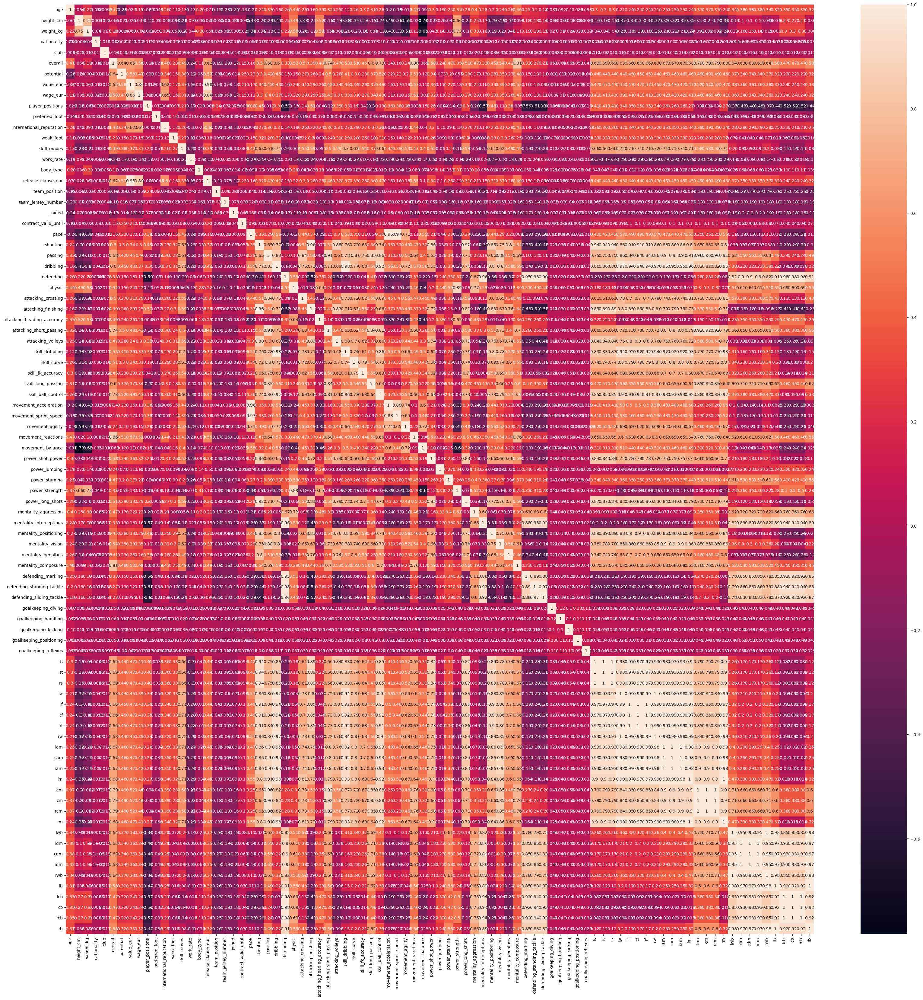

In [50]:
plt.figure(figsize=(40,40))
sns.heatmap(data.corr(),annot=True)

#### Observations:
- Though the heatmap as a whole is clearly not interpretable due to large volume of columns, we certainly see some zones of high correlation. 
- Observing those set of columns, separately, we get an idea of correlation between elements and that can be addressed. 

<AxesSubplot:>

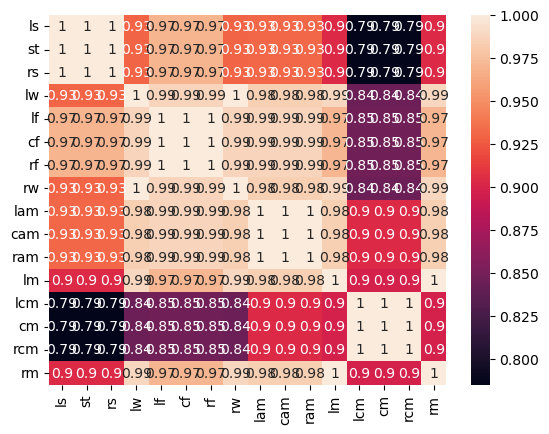

In [51]:
sns.heatmap(data.loc[:,'ls':'rm'].corr(),annot=True)

<AxesSubplot:>

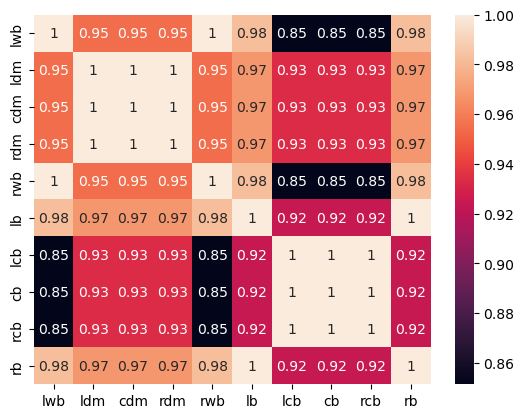

In [52]:
sns.heatmap(data.loc[:,'lwb':'rb'].corr(),annot=True)

- All these features have high correlation between 0.79-1. These highly correlated features, if existing, might bias the cluster formation. We hence have to drop them
- We'll retain lcb and ls features, and we'll drop the rest. 
- We'll then analyse the heat map again with the remaining features.

In [53]:
data.drop(['st', 'rs','lw', 'lf', 'cf', 'rf', 'rw', 'lam', 'cam', 'ram', 'lm', 'lcm', 'cm','rcm', 'rm', 'lwb', 'ldm', 'cdm', 'rdm', 'rwb', 'lb', 'cb','rcb', 'rb'],axis=1,inplace=True)

- Let us analyse the heatmap of leftover features once again

<AxesSubplot:>

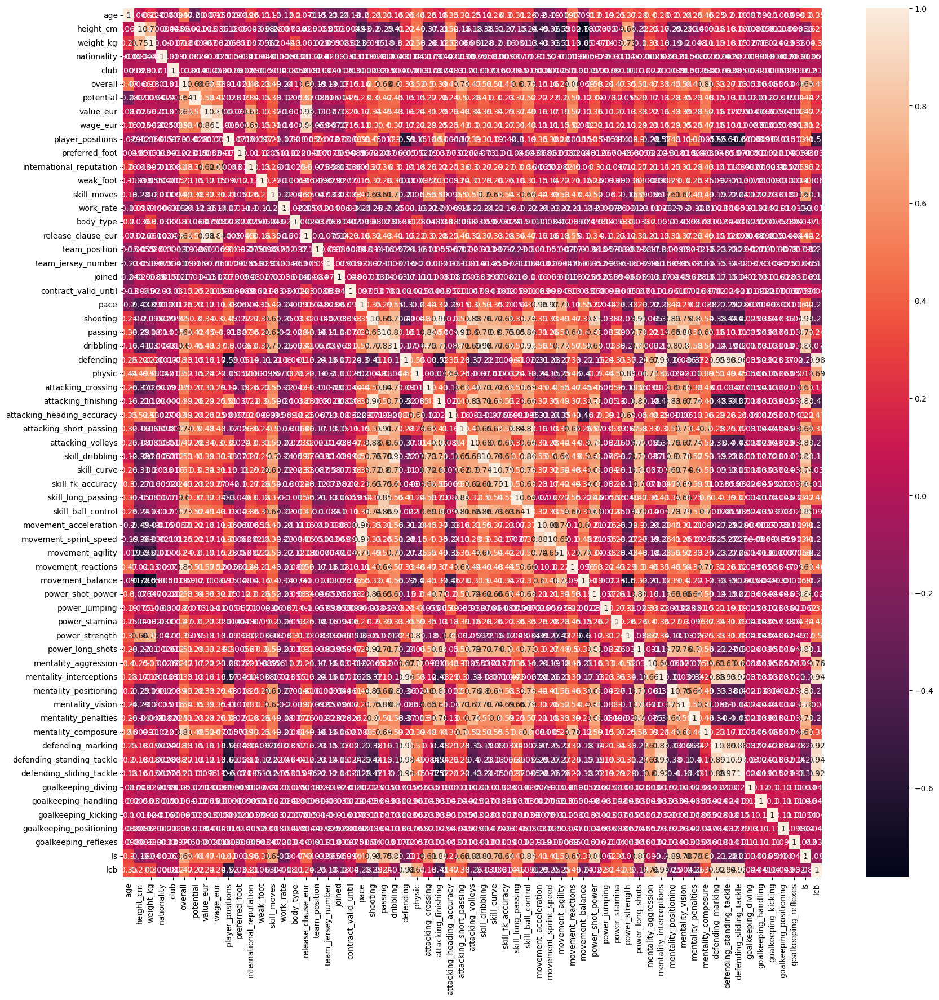

In [54]:
plt.figure(figsize=(20,20))
sns.heatmap(data.corr(),annot=True)

<AxesSubplot:>

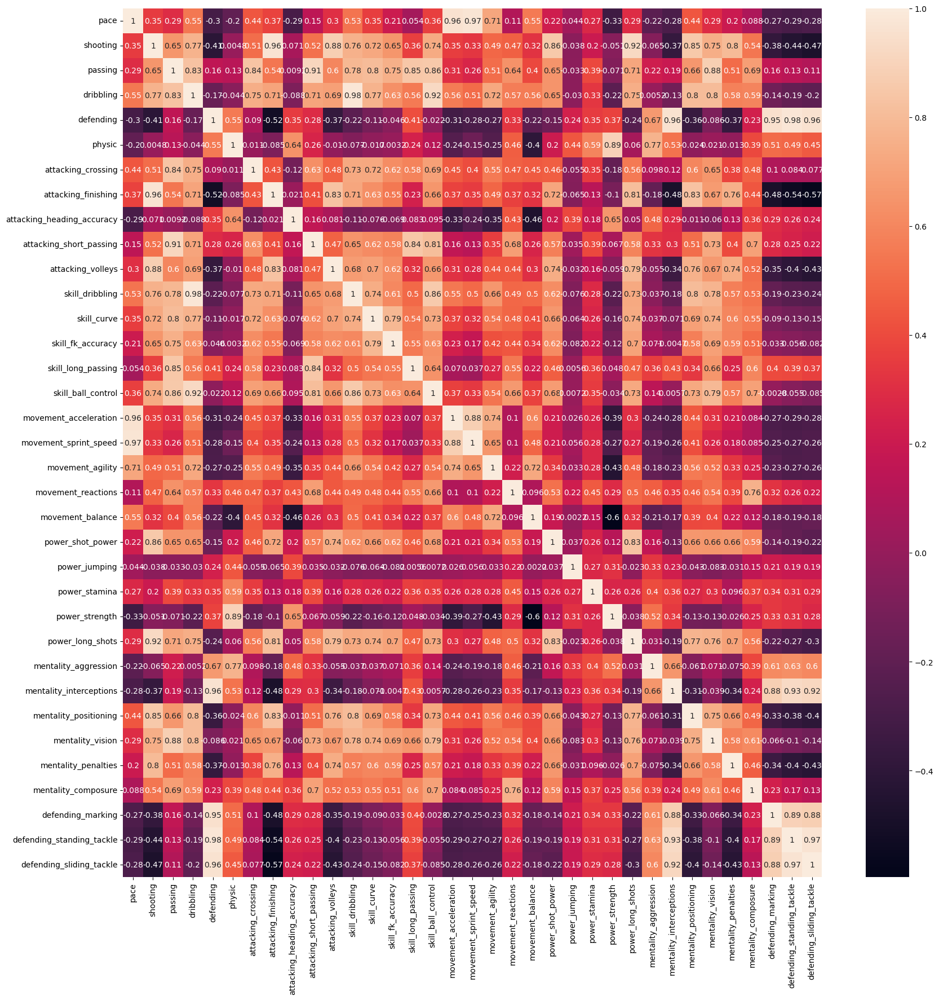

In [55]:
plt.figure(figsize=(20,20))
sns.heatmap(data.loc[:,'pace':'defending_sliding_tackle'].corr(),annot=True)

- Feature 'defending' is highly correlated with 'defending_marking', 'defending_standing_tackle', 'defending_sliding_tackle'. So, we'll retain 'defending' and drop the others.
- Feature 'attacking_volleys' is correlated with 'mentality_penalties','mentality_vision','mentality_positioning','power_long_shots','power_shot_power','attacking_finishing','shooting'. We'll retain 'attacking_volleys' and drop others
- We'll drop these features, and observe heat map again. 

In [56]:
data.drop(['mentality_penalties','mentality_vision','mentality_positioning','power_long_shots','power_shot_power','attacking_finishing','shooting','defending_marking', 'defending_standing_tackle', 'defending_sliding_tackle'],axis=1,inplace=True)

<AxesSubplot:>

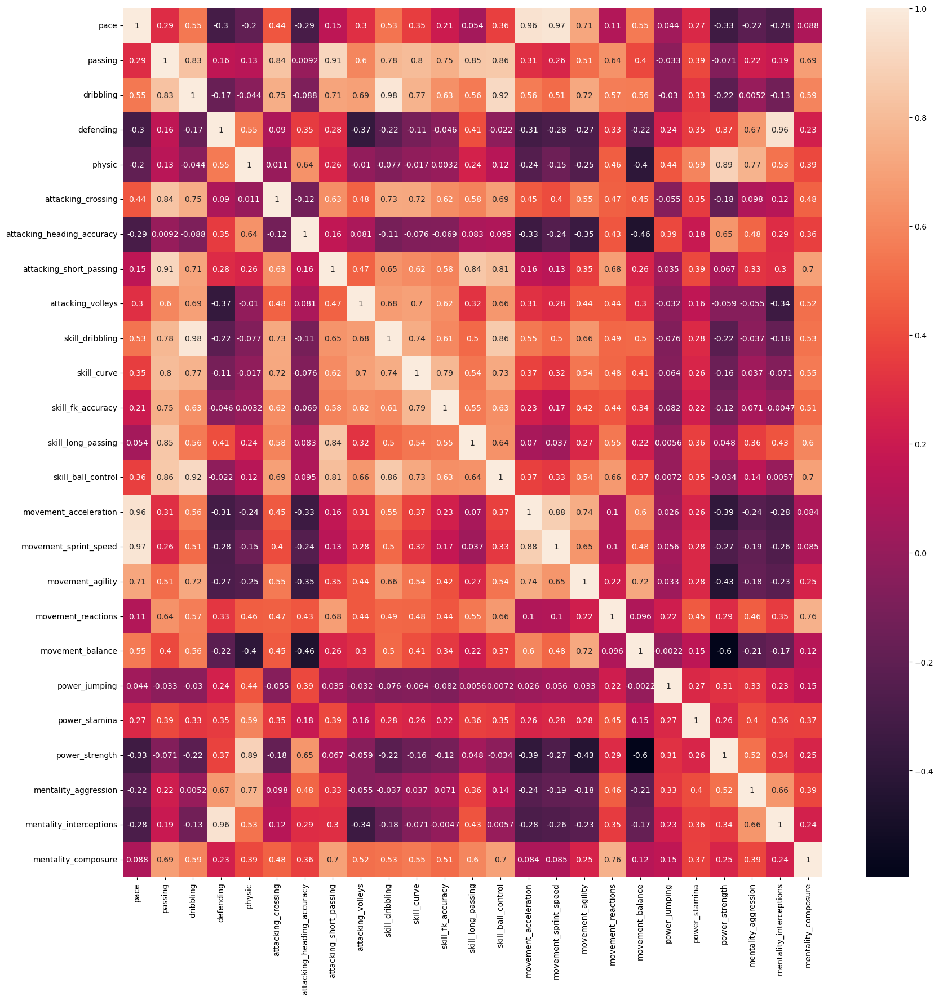

In [57]:
plt.figure(figsize=(20,20))
sns.heatmap(data.loc[:,'pace':'mentality_composure'].corr(),annot=True)

- Features that are highly correlated are:
  - 'movement_acceleration','movement_sprint_speed'
  - 'mentality_composure','attacking_short_passing','skill_ball_control','movement_reactions'
  - 'mentality_interceptions', 'defending'
  - 'mentality_aggression,'physic'
  - 'power_strength','physic'
  - 'movement_balance','movement_agility'
  - 'pace','movement_acceleration','movement_sprint_speed'
  - 'passing','dribbling','attacking_crossing','attacking_short_passing','skill_dribbling','skill_curve', 'skill_fk_accuray','skill_long_passing','skill_ball_control'
- We'll retain, 'mentality_acceleration','mentality_composure','defending','physic','movement_balance','pace','passing' and drop others and observe heat map again

In [58]:
data.drop(['movement_sprint_speed','attacking_short_passing','skill_ball_control','movement_reactions','mentality_interceptions','mentality_aggression','power_strength','movement_agility','movement_acceleration','movement_sprint_speed','dribbling','attacking_crossing','attacking_short_passing','skill_dribbling','skill_curve', 'skill_fk_accuracy','skill_long_passing','skill_ball_control'],axis=1,inplace=True)

<AxesSubplot:>

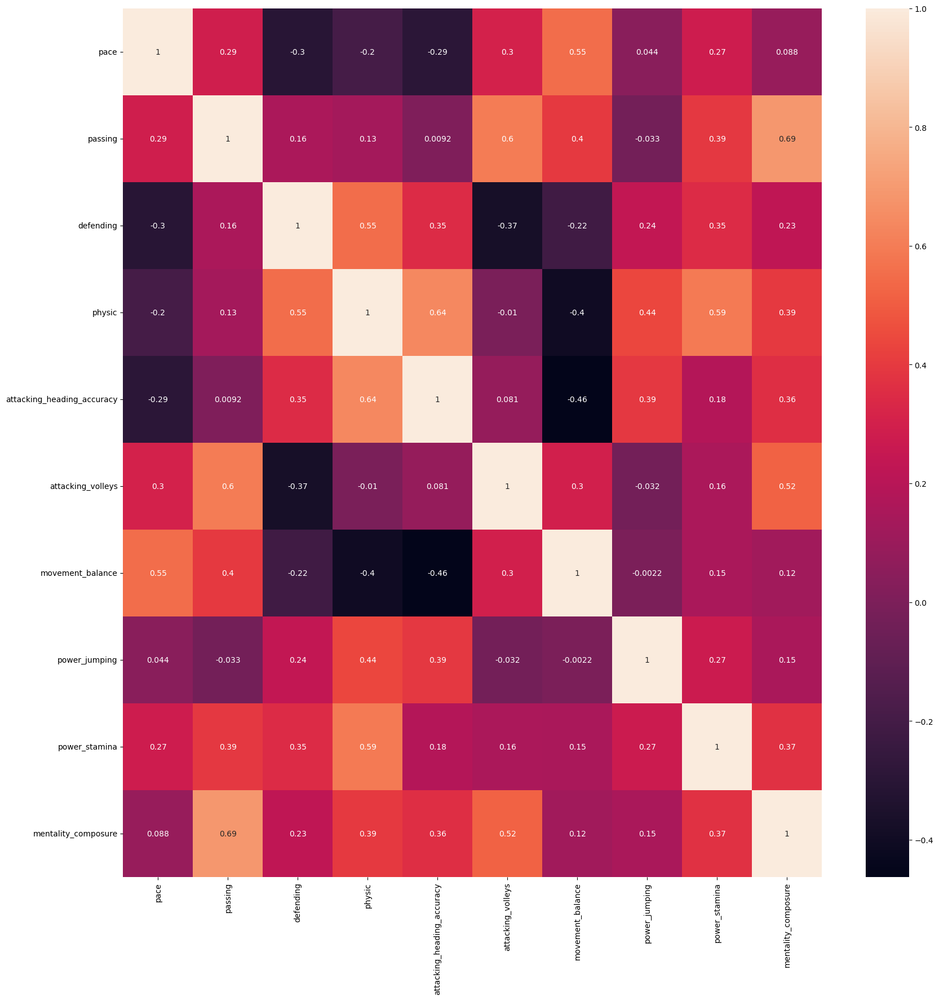

In [59]:
plt.figure(figsize=(20,20))
sns.heatmap(data.loc[:,'pace':'mentality_composure'].corr(),annot=True)

<AxesSubplot:>

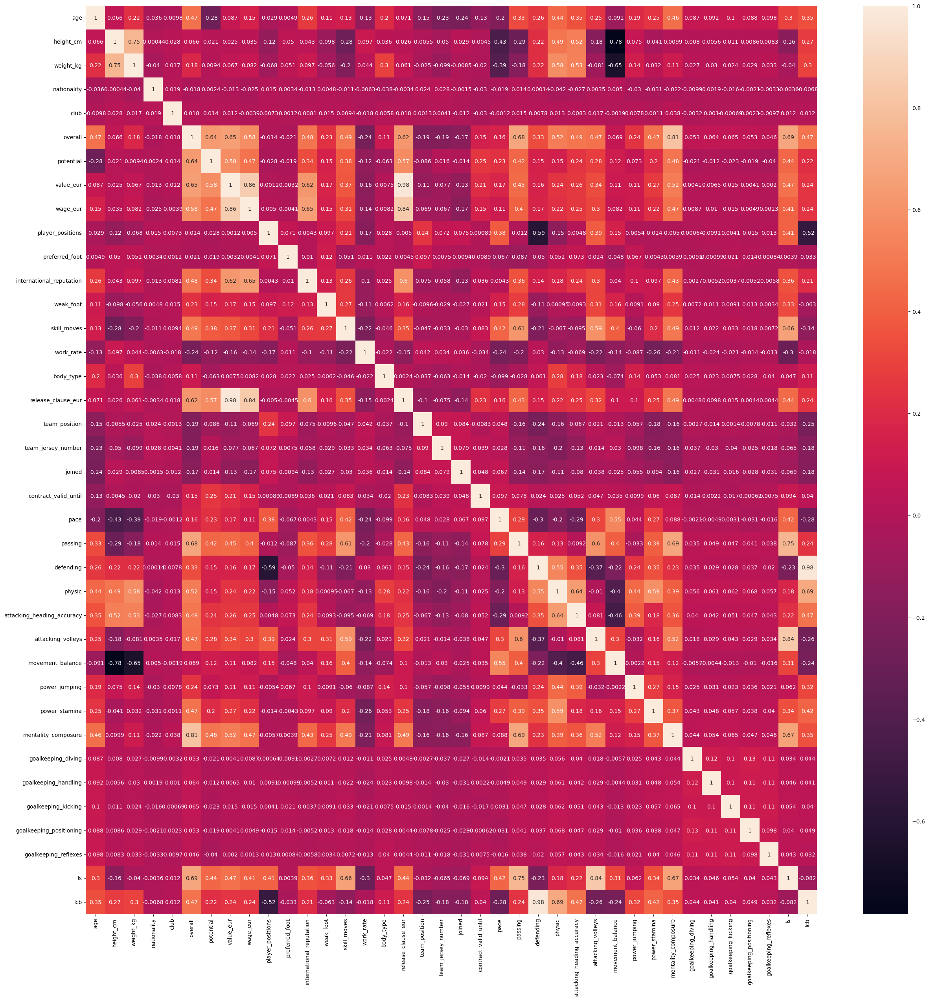

In [60]:
# The set of features seem to be good.
# lets look at over all heat map again
plt.figure(figsize=(30,30))
sns.heatmap(data.corr(),annot=True)

- Features that are highly corrleated are:
  - 'lcb' and 'defending'
  - 'overall','mentality_composure'
  - 'height_cm','weight_kg'
  - 'ls','attacking_volleys','passing'
  - 'value_eur','release_clause_eur','wage_eur'
  - 'height','movement_balance'
- We'll drop 'lcb','mentality_composure','weight_kg','ls','attacking_volleys','value_eur','release_clause_eur' and retain others.

In [61]:
data.drop(['lcb','mentality_composure','weight_kg','ls','attacking_volleys','value_eur','release_clause_eur','movement_balance'],axis=1,inplace=True)

<AxesSubplot:>

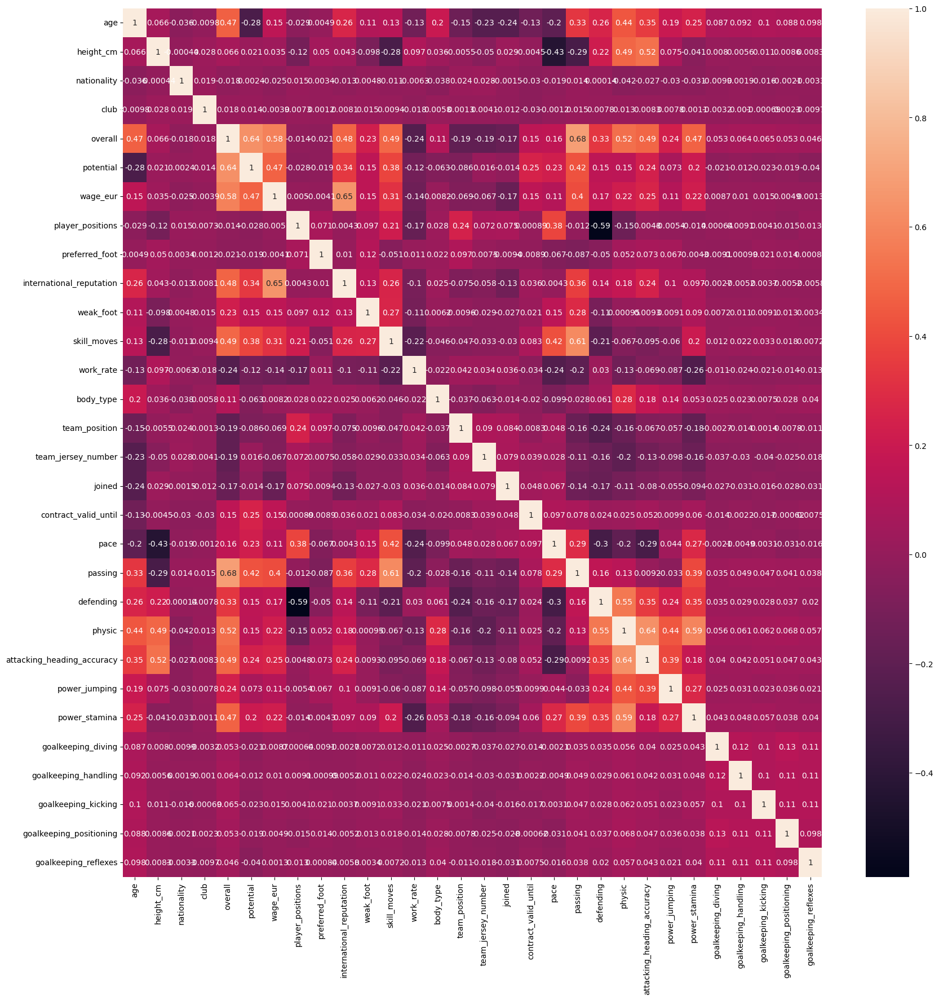

In [62]:
plt.figure(figsize=(20,20))
sns.heatmap(data.corr(),annot=True)

- We now ended up in a decent correlation map. 
- We still can filter out features using principal component analysis.
- The resulting features from PCA are not interpretable, and hence we are not choosing it. 
- A clustering model with PCA features shall also be presented at the end.

## Modeling.
- As described in the features, overall is a feature that has the overall rating of the player.
- Since that feature might highly influence the clusters, we drop it, as per the given information. 
- Ref: Metadata 
    - 'overall: General performance quality and value of the player representing the key positional skills and international reputation rated between 1-99. Overall attribute is used only in preprocessing and discussion stages because using it in modelling could lead to domination by this feature. The aim of the project is not basically sort and categorize the players using their overall talent and international reputation, but to cluster them based on using their whole skillset.'

### Scaling - Scaling is needed so that the distances do not affect the clustering

In [63]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
x_sc = sc.fit_transform(data.drop(['overall'],axis = 1))

In [64]:
#Setting up input
x = pd.DataFrame(x_sc,columns = data.drop(['overall'],axis = 1).columns )

In [65]:
#Before clustering, we'll figure out the no. of unique values of overall variable, so that it shall be used to evaluate the model if necessary
print('Overall column contains: ',len(data.overall.unique()),' values')
print('unique values are ', data.overall.unique())
print('value counts are :\n',data.overall.value_counts())

Overall column contains:  47  values
unique values are  [94 93 92 91 90 89 88 87 86 85 84 83 82 81 80 79 78 77 76 75 74 73 72 71
 70 69 68 67 66 65 64 63 62 61 60 59 58 57 56 55 54 53 52 51 50 49 48]
value counts are :
 64    1024
66    1018
65    1014
68     974
67     965
69     876
63     836
70     821
62     762
72     695
71     652
60     609
61     580
73     570
74     491
59     476
75     458
58     409
76     325
56     302
57     296
77     241
55     228
78     219
54     195
79     173
53     156
80     135
52     128
51      90
82      79
50      76
81      74
83      69
49      52
84      43
48      39
85      30
86      17
87      14
88      12
89      11
90       3
91       2
93       1
92       1
94       1
Name: overall, dtype: int64


In [66]:
#We can divide the overall rating into 5 groups, based on range of overall rating, namely A:90-100,B:80-89,C:70-79,D:60-69,E-<60
data['grade'] = 0
for i,j in enumerate(data.overall):
    if j>=90:
        data['grade'][i] = 4
    elif j>=80:
        data['grade'][i] = 3
    elif j>=70:
        data['grade'][i] = 2
    elif j>=60:
        data['grade'][i] = 1
    else:
        data['grade'][i] = 0

/var/folders/r0/clh_3js14qv9pk7zdswj1yg00000gn/T/ipykernel_59792/2523779291.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['grade'][i] = 4
/var/folders/r0/clh_3js14qv9pk7zdswj1yg00000gn/T/ipykernel_59792/2523779291.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['grade'][i] = 3
/var/folders/r0/clh_3js14qv9pk7zdswj1yg00000gn/T/ipykernel_59792/2523779291.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['grade']

In [67]:
data.grade

0        4
1        4
2        4
3        4
4        4
5        4
6        4
7        4
8        3
9        3
10       3
11       3
12       3
13       3
14       3
15       3
16       3
17       3
18       3
19       3
20       3
21       3
22       3
23       3
24       3
25       3
26       3
27       3
28       3
29       3
30       3
31       3
32       3
33       3
34       3
35       3
36       3
37       3
38       3
39       3
40       3
41       3
42       3
43       3
44       3
45       3
46       3
47       3
48       3
49       3
50       3
51       3
52       3
53       3
54       3
55       3
56       3
57       3
58       3
59       3
60       3
61       3
62       3
63       3
64       3
65       3
66       3
67       3
68       3
69       3
70       3
71       3
72       3
73       3
74       3
75       3
76       3
77       3
78       3
79       3
80       3
81       3
82       3
83       3
84       3
85       3
86       3
87       3
88       3
89       3
90       3

In [68]:
#Since we have five clusters, we'll model the data into five clusters.
from sklearn.cluster import KMeans
model = KMeans(n_clusters = 5,random_state = 42)
model.fit(x)
model.labels_

array([2, 2, 2, ..., 4, 4, 4], dtype=int32)

In [69]:
model.cluster_centers_

array([[ 2.72692289e-01,  7.84058723e-01, -2.68308121e-02,
         9.81048455e-03, -2.26491859e-01, -1.76312037e-01,
        -8.26337677e-01,  8.28173140e-02, -1.78486692e-01,
        -3.34262079e-01, -7.87055289e-01,  3.27836340e-01,
         2.08822179e-01, -1.41635420e-01, -2.11078842e-01,
        -8.52278604e-02, -1.02766495e-01, -8.81876628e-01,
        -6.00497064e-01,  7.95180769e-01,  6.20196326e-01,
         5.93717454e-01,  2.90020596e-01, -6.70826134e-02,
         4.10722018e-02,  3.06702907e-02,  3.64712504e-02,
         4.51596638e-02,  4.59964649e-02],
       [ 2.47734482e-01, -4.75743139e-01, -1.38513317e-02,
         1.24734543e-02,  1.90274227e-01, -2.80496573e-03,
        -1.02835844e-01, -1.87066228e-01, -2.00598218e-01,
         2.24731941e-01,  5.87010178e-01, -3.79619096e-01,
        -1.97768563e-02, -3.63002308e-01, -1.84563282e-01,
        -1.41772912e-01,  8.76217137e-02,  5.00359765e-01,
         7.35384799e-01,  3.45253141e-01,  2.36122797e-01,
        -2.06

In [70]:
model.inertia_

375598.00919687876

In [71]:
#Lets compare with out clusters to see if it works.
Results = pd.DataFrame(columns=["K_Means","Actual"])
Results["K_Means"] = model.labels_
Results["Actual"] = data.grade
pd.set_option('display.max_rows',None)
Results
(Results.K_Means!=Results.Actual).sum()

13041

- The model seems to have high inertia. And the comparison shows that there have been 13041 mismatches too. In anycase, we do not deem it to be right fit. 
- We'll use Elbow technique to find the right/optimum k

In [74]:
#Let us find out WCSS for different k and then choose the right number of clusters
Results_wcss = pd.DataFrame(columns = ['k_value','wcss'])
k_value_list = []
wcss_list = []
for i in range(2,50):
    model = KMeans(n_clusters = i,random_state = 42)
    model.fit(x)
    k_value_list.append(i)
    wcss_list.append(model.inertia_)
Results_wcss['k_value'] = k_value_list
Results_wcss['wcss'] = wcss_list
Results_wcss

,k_value,wcss
0,2,430455.637630
1,3,404288.430071
2,4,386964.518965
3,5,375598.009197
4,6,367267.993144
5,7,361078.778732
6,8,355415.920488
7,9,350949.743133
8,10,344986.151812
9,11,340264.910592


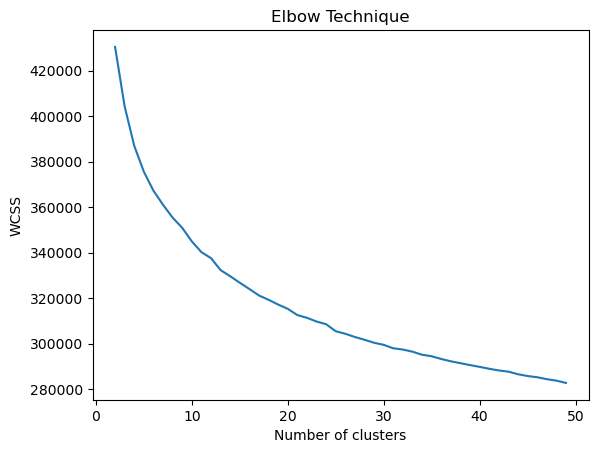

In [75]:
plt.plot(Results_wcss.k_value,Results_wcss.wcss)
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.title('Elbow Technique')
plt.show()

#### From the elbow technique it is evident that the optimal clusters shall be 7 or 12 or 25. 

In [80]:
# Model with optimal number of clusters 7
from sklearn.cluster import KMeans
model = KMeans(n_clusters = 7,random_state = 42)
model.fit(x)
model.labels_

array([1, 1, 1, ..., 0, 0, 0], dtype=int32)

In [81]:
from sklearn.metrics import silhouette_score
ss = silhouette_score(x,model.labels_)
ss

0.04899045072508195

In [76]:
# Model with optimal number of clusters 12
from sklearn.cluster import KMeans
model = KMeans(n_clusters = 12,random_state = 42)
model.fit(x)
model.labels_

array([ 6,  6,  6, ..., 10,  7,  7], dtype=int32)

In [77]:
from sklearn.metrics import silhouette_score
ss = silhouette_score(x,model.labels_)
ss

0.04762787297796944

In [78]:
# Model with optimal number of clusters 25
from sklearn.cluster import KMeans
model = KMeans(n_clusters = 25,random_state = 42)
model.fit(x)
model.labels_

array([15, 15, 15, ..., 14,  4,  4], dtype=int32)

In [79]:
from sklearn.metrics import silhouette_score
ss = silhouette_score(x,model.labels_)
ss

0.040492676658928764

### PCA on these 29 columns

In [84]:
len(data.drop(['overall','grade'],axis=1).columns)

29

In [85]:
len(x.columns)

29

In [86]:
from sklearn.decomposition import PCA
pca = PCA()
new_x = pca.fit_transform(x)
new_x = pd.DataFrame(new_x)
new_x.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28
0,13.614738,11.256326,-7.534822,-1.874104,12.141051,-1.138110,4.823369,2.186654,2.937089,7.715600,1.450138,-0.340280,1.652105,-1.610840,-3.348838,-0.832244,-1.884031,2.398344,0.578639,0.453224,1.655536,8.707544,1.617566,2.350421,10.810194,-0.712316,-0.161161,-0.266125,-0.695399
1,13.009820,9.170963,-5.376705,-5.040566,7.771598,0.218804,1.599138,2.163811,2.047190,2.605217,-1.155148,0.263793,1.743631,-0.535144,-1.769875,-1.267341,-3.240839,3.825396,2.359180,3.147989,-0.356072,5.380674,2.607931,1.307896,6.179819,0.180034,-0.073795,-0.233079,0.002485
2,9.254033,9.931077,-4.679193,-1.434888,7.151782,0.092109,2.094082,0.038271,-1.112462,1.465226,-0.111597,0.368841,2.122181,-0.162492,-0.905215,-0.973093,-1.860283,4.027667,2.249358,1.550314,0.497253,5.196343,1.736452,0.822304,2.356751,0.816679,0.310910,-0.728128,0.250311
3,10.562321,10.180335,-7.335696,-3.094554,6.968239,-0.372321,3.600312,0.967962,-0.432282,2.382732,1.214539,-1.366984,-0.295788,-1.326175,-1.029265,-1.829916,-1.372444,2.554549,4.630455,2.085501,0.102711,7.614804,1.881334,1.770799,9.824471,-0.687289,0.162627,-0.217914,-0.197493
4,11.153247,8.044253,-5.748304,-1.353529,6.575547,0.398141,2.132118,-0.074196,-0.081777,2.022534,2.067790,-1.119619,-0.657811,-0.532133,1.036996,-1.348471,-1.171535,0.960361,3.606185,1.289733,1.832276,6.112262,2.497955,1.768040,6.139041,-0.883707,-0.128006,-0.288751,-0.383468


In [87]:
pca.explained_variance_ratio_

array([0.13495436, 0.11014671, 0.06031966, 0.05637726, 0.04845775,
       0.04548563, 0.03640084, 0.03560665, 0.03408333, 0.03323281,
       0.03275899, 0.03163769, 0.03092381, 0.03053809, 0.03021595,
       0.02991754, 0.02889962, 0.02762484, 0.02696296, 0.02582567,
       0.02511071, 0.02062633, 0.01459092, 0.01149015, 0.01075219,
       0.0089447 , 0.00818888, 0.00568445, 0.00424151])

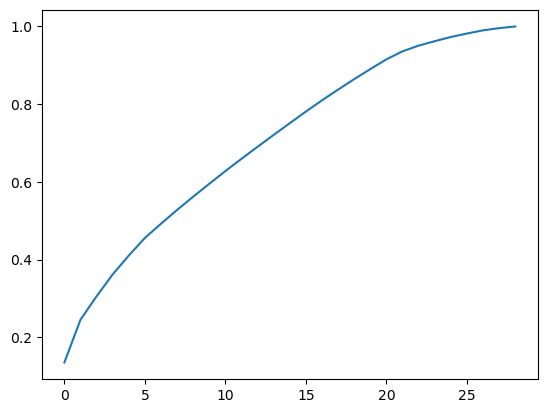

In [88]:
#Scree plots to find right value of features
plt.plot(np.cumsum(pca.explained_variance_ratio_))

- Around 20 features explain around 90% of variance in data. If we can go till 25 features, we can account to 95% of variance of data.
- Lets take 20 features.

In [89]:
pca = PCA(n_components=20)
new_x = pca.fit_transform(x)
new_x = pd.DataFrame(new_x)
new_x.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,13.614738,11.256326,-7.534822,-1.874104,12.141051,-1.138110,4.823369,2.186654,2.937089,7.715600,1.450138,-0.340280,1.652105,-1.610840,-3.348838,-0.832244,-1.884031,2.398344,0.578639,0.453224
1,13.009820,9.170963,-5.376705,-5.040566,7.771598,0.218804,1.599138,2.163811,2.047190,2.605217,-1.155148,0.263793,1.743631,-0.535144,-1.769875,-1.267341,-3.240839,3.825396,2.359180,3.147989
2,9.254033,9.931077,-4.679193,-1.434888,7.151782,0.092109,2.094082,0.038271,-1.112462,1.465226,-0.111597,0.368841,2.122181,-0.162492,-0.905215,-0.973093,-1.860283,4.027667,2.249358,1.550314
3,10.562321,10.180335,-7.335696,-3.094554,6.968239,-0.372321,3.600312,0.967962,-0.432282,2.382732,1.214539,-1.366984,-0.295788,-1.326175,-1.029265,-1.829916,-1.372444,2.554549,4.630455,2.085501
4,11.153247,8.044253,-5.748304,-1.353529,6.575547,0.398141,2.132118,-0.074196,-0.081777,2.022534,2.067790,-1.119619,-0.657811,-0.532133,1.036996,-1.348471,-1.171535,0.960361,3.606185,1.289733


In [90]:
#Let us find out WCSS for different k and then choose the right number of clusters
Results1_wcss = pd.DataFrame(columns = ['k_value','wcss'])
k_value_list = []
wcss_list = []
for i in range(2,30):
    model = KMeans(n_clusters = i,random_state = 42)
    model.fit(new_x)
    k_value_list.append(i)
    wcss_list.append(model.inertia_)
Results1_wcss['k_value'] = k_value_list
Results1_wcss['wcss'] = wcss_list
Results1_wcss

,k_value,wcss
0,2,378866.755501
1,3,352856.773988
2,4,336062.384894
3,5,324897.158142
4,6,317106.399320
5,7,310914.156973
6,8,305496.091871
7,9,300516.808154
8,10,295859.118452
9,11,291859.153254


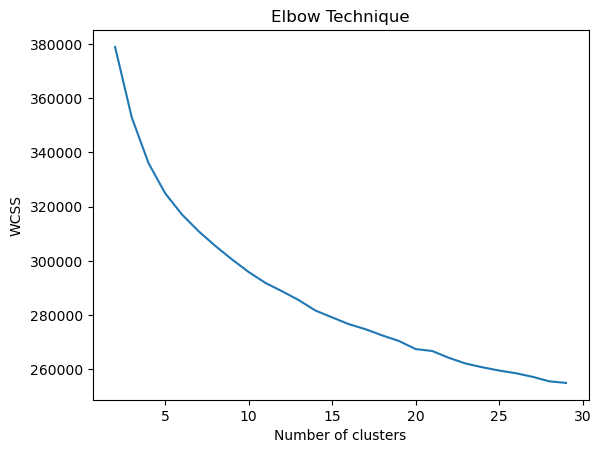

In [91]:
plt.plot(Results1_wcss.k_value,Results1_wcss.wcss)
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.title('Elbow Technique')
plt.show()

- No of clusters as evident from scree plot could be 6, or 15

In [92]:
# Model with optimal number of clusters 6
from sklearn.cluster import KMeans
model = KMeans(n_clusters = 6,random_state = 42)
model.fit(new_x)
model.labels_

array([2, 2, 2, ..., 4, 4, 4], dtype=int32)

In [93]:
ss = silhouette_score(new_x,model.labels_)
ss

0.06870291134777919

In [94]:
# Model with optimal number of clusters 10
from sklearn.cluster import KMeans
model = KMeans(n_clusters = 10,random_state = 42)
model.fit(new_x)
model.labels_

array([3, 3, 3, ..., 8, 8, 8], dtype=int32)

In [95]:
ss = silhouette_score(new_x,model.labels_)
ss

0.057721159903619576

### PCA: We had 87 features in total originally (after filtering null rows and columns). Of them, from heat map analysis we filtered out to have only 30 columns. 
### Let us do pca on 87 features, so that we have best combination of least count of features that capture 90% of total variance. 

In [76]:
data.drop('grade',axis=1,inplace=True)

In [77]:
len(data.columns)

30

In [78]:
len(data2.columns)

87

### To efficiently use PCA, we need to scale our data.

In [84]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
x_sc = sc.fit_transform(data2.drop(['overall'],axis = 1))
x_sc = pd.DataFrame(x_sc)

In [85]:
from sklearn.decomposition import PCA
pca = PCA()
new_x = pca.fit_transform(x_sc)
new_x = pd.DataFrame(new_x)
new_x.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85
0,25.612767,0.546920,5.522252,16.846105,20.342527,14.730120,-2.569293,4.408726,-2.364035,-0.679602,-2.612741,-2.895528,-1.149704,0.506687,-0.286970,0.440866,1.233794,3.734439,1.827581,-0.067220,-0.714802,3.247196,1.707372,4.859658,3.035047,-1.797910,0.169266,-2.640385,-3.413365,-3.004472,0.413021,0.613128,1.924388,0.022294,-0.410198,-0.380017,0.702672,-0.585610,1.047121,0.054521,-3.055462,-5.967065,0.122516,-0.095541,-0.155476,-0.515580,-0.668956,0.217412,-0.218715,-0.341711,-0.030104,-0.157887,0.255294,-1.027399,-0.035547,0.054237,-0.112253,0.024060,-0.080609,-0.069471,-0.114020,0.201948,-0.279364,-0.078046,-0.025364,-0.023350,0.045595,-0.019544,-0.006230,0.000383,-1.495723e-13,3.967005e-15,-9.582705e-15,-1.549972e-15,-2.378201e-17,-2.176599e-16,-8.723782e-16,-3.544277e-16,1.185590e-17,-2.368050e-16,2.081570e-16,2.840344e-16,1.068167e-16,8.114719e-17,9.790262e-16,-1.414403e-16
1,21.790577,-0.374364,7.667622,13.008173,10.756522,7.993046,-1.067997,1.879516,-2.405347,-0.354604,-1.147831,0.496156,-0.999046,3.225351,1.478491,0.300573,-0.398077,0.585429,0.770813,-2.351519,-1.199911,3.204293,-1.194781,1.813440,-0.803408,-1.225495,-0.334944,0.297443,-0.673442,0.082755,1.036177,0.790022,1.018039,0.284676,-0.768362,0.265024,-0.466727,-0.225991,0.782840,1.038172,-3.215953,-6.193122,-0.081616,0.282160,-0.215010,-0.256563,-0.742942,0.157225,-0.148510,0.068997,0.076997,0.277385,0.160673,0.576711,0.056555,-0.049293,-0.007630,0.002751,-0.006966,-0.023746,0.009547,0.111141,-0.047360,-0.025212,0.012286,0.016167,0.015436,-0.012549,0.020668,-0.010154,6.303441e-14,1.493731e-14,-1.165077e-14,-8.978918e-16,8.428388e-16,-7.192372e-17,-7.661824e-16,6.871264e-17,-4.763535e-16,-1.008402e-16,-4.925332e-16,-1.207975e-17,-3.522282e-16,4.427276e-16,1.024290e-15,1.946221e-16
2,23.134505,-1.413308,3.734668,15.025432,17.209716,10.797974,-0.740273,2.895692,0.303790,-2.456719,0.631140,0.328659,-2.297278,3.931395,0.661579,1.783256,1.083274,1.234187,0.674718,-1.136885,-2.276499,3.449916,-0.640541,2.232583,2.017040,-0.364707,-0.202526,-2.321619,-2.268394,-1.560279,1.165169,-0.490003,0.366231,-0.096775,-0.428526,0.193302,0.040321,-0.828993,-0.247530,0.210912,2.272300,3.036238,-0.059462,-0.311051,0.985008,0.046853,0.104172,-0.305792,-0.205935,-0.036905,-0.179583,0.097053,-0.389276,0.605202,-0.046985,-0.088359,-0.061830,-0.025927,0.048224,0.037614,-0.038025,0.054764,-0.126987,-0.012249,-0.003790,-0.005125,0.002316,-0.017795,0.014106,-0.016821,-1.488367e-14,-1.917067e-15,-3.763557e-16,8.883551e-16,-1.622861e-15,2.709140e-16,-1.579430e-16,2.646987e-16,-4.556912e-16,-6.663632e-16,-1.096611e-15,-1.095859e-15,-2.343816e-17,-1.540717e-16,-1.689628e-15,-9.951283e-16
3,22.568725,-0.415577,4.258740,16.471924,17.530198,9.684762,-1.842203,3.222913,0.529002,-1.327007,0.628746,-1.067786,-3.352487,1.342759,-0.080882,2.249005,-0.612496,0.839700,-1.297535,-0.636279,-3.827977,4.807850,-0.227449,3.729233,2.555163,-0.912227,0.568763,-3.541655,-3.543707,-2.844079,0.137055,-0.796552,2.188912,-0.038907,-0.450419,-0.075747,-0.465234,-1.035007,0.476358,0.264766,-2.258668,-3.832026,-0.160563,0.021705,-0.271907,-0.057926,-0.499527,-0.050361,-0.368750,-0.198079,-0.357810,-0.386790,-0.064899,-0.905262,0.063626,-0.010946,0.003523,0.070495,-0.062072,0.031126,-0.014137,0.030884,0.002609,0.023210,0.022622,-0.013288,0.026074,0.025556,0.011399,0.012621,1.200898e-14,3.341418e-16,-3.818043e-16,1.029118e-15,-4.536140e-16,-4.892682e-16,-6.339691e-16,-2.644315e-16,-6.910899e-16,-8.340240e-16,1.350440e-15,-2.034532e-16,-8.190987e-16,1.000259e-15,7.188759e-16,-2.549667e-16
4,22.700213,5.556716,4.440202,12.809226,15.597978,9.003373,-0.690459,2.024952,0.059641,-0.807668,0.406089,-0.799407,-2.727157,0.843289,-0.703192,4.141926,0.535357,0.069043,-1.469803,-0.827788,-

In [86]:
pca.explained_variance_ratio_

array([3.71915983e-01, 2.11210582e-01, 6.21111916e-02, 3.29510835e-02,
       2.94649854e-02, 1.79471410e-02, 1.56812193e-02, 1.37646222e-02,
       1.25152570e-02, 1.17441575e-02, 1.16585023e-02, 1.12168544e-02,
       1.09017049e-02, 1.07087090e-02, 1.06279635e-02, 1.04267706e-02,
       1.02972379e-02, 1.01571931e-02, 1.00042077e-02, 9.83575171e-03,
       9.38240587e-03, 8.67183832e-03, 8.13494330e-03, 7.74794466e-03,
       7.04953659e-03, 6.01857467e-03, 5.57750335e-03, 4.92317997e-03,
       4.73271099e-03, 4.38310555e-03, 3.70427492e-03, 3.53958112e-03,
       3.32358325e-03, 3.04751535e-03, 2.85662694e-03, 2.79350165e-03,
       2.75714511e-03, 2.60995034e-03, 2.38141217e-03, 2.30167927e-03,
       2.05019150e-03, 1.96140064e-03, 1.88256878e-03, 1.73720940e-03,
       1.69987494e-03, 1.59779957e-03, 1.47551959e-03, 1.34034430e-03,
       1.28645374e-03, 1.21308491e-03, 9.60801866e-04, 8.78716882e-04,
       3.59449244e-04, 2.23554223e-04, 3.27051858e-05, 3.01536568e-05,
      

In [87]:
np.cumsum(pca.explained_variance_ratio_)

array([0.37191598, 0.58312656, 0.64523776, 0.67818884, 0.70765383,
       0.72560097, 0.74128219, 0.75504681, 0.76756206, 0.77930622,
       0.79096472, 0.80218158, 0.81308328, 0.82379199, 0.83441996,
       0.84484673, 0.85514397, 0.86530116, 0.87530537, 0.88514112,
       0.89452352, 0.90319536, 0.91133031, 0.91907825, 0.92612779,
       0.93214636, 0.93772386, 0.94264704, 0.94737976, 0.95176286,
       0.95546714, 0.95900672, 0.9623303 , 0.96537782, 0.96823444,
       0.97102794, 0.97378509, 0.97639504, 0.97877645, 0.98107813,
       0.98312832, 0.98508972, 0.98697229, 0.9887095 , 0.99040938,
       0.99200718, 0.9934827 , 0.99482304, 0.99610949, 0.99732258,
       0.99828338, 0.9991621 , 0.99952155, 0.9997451 , 0.99977781,
       0.99980796, 0.99983581, 0.99985953, 0.99988176, 0.99990314,
       0.99992335, 0.9999419 , 0.99995907, 0.99997005, 0.99997686,
       0.99998308, 0.99998893, 0.99999388, 0.99999738, 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.     

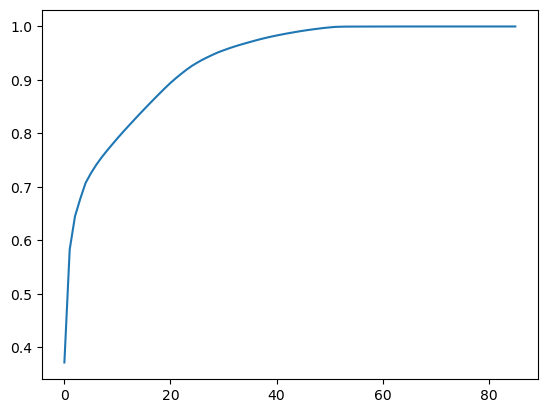

In [88]:
plt.plot(np.cumsum(pca.explained_variance_ratio_))

- From the scree plot, it is evident that, around 20 Principal Components are enough to amount to 90% of variance, and around 30 PCs amount oto 95% of variance. 
- We shall take our PC as 30.

In [89]:
pca = PCA(n_components=30)
new_x1 = pd.DataFrame(pca.fit_transform(x_sc))
new_x1.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29
0,25.612767,0.546920,5.522253,16.846168,20.342492,14.730263,-2.569785,4.408259,-2.366086,-0.682588,-2.610995,-2.892616,-1.149990,0.503916,-0.284543,0.440460,1.236789,3.738056,1.821736,-0.072653,-0.708700,3.242703,1.705386,4.849997,3.022067,-1.818251,0.138374,-2.626816,-3.393348,-2.997496
1,21.790578,-0.374364,7.667623,13.008226,10.756481,7.993108,-1.068316,1.879115,-2.407532,-0.356185,-1.146862,0.496706,-0.999513,3.224171,1.480422,0.299566,-0.395253,0.588899,0.765039,-2.355382,-1.193385,3.201581,-1.195063,1.802540,-0.816559,-1.237500,-0.352506,0.285896,-0.624701,0.091572
2,23.134505,-1.413308,3.734668,15.025411,17.209744,10.797968,-0.740118,2.896054,0.304986,-2.456315,0.631056,0.329094,-2.296953,3.931082,0.660864,1.784436,1.082357,1.233444,0.676922,-1.135082,-2.278589,3.451478,-0.642266,2.240135,2.025427,-0.372031,-0.206570,-2.268979,-2.278182,-1.568843
3,22.568725,-0.415577,4.258741,16.471964,17.530168,9.684830,-1.842529,3.222550,0.527440,-1.328747,0.629747,-1.066276,-3.352870,1.341072,-0.079295,2.248737,-0.610270,0.841997,-1.302539,-0.640026,-3.823203,4.804479,-0.228139,3.722985,2.545457,-0.931117,0.544906,-3.524459,-3.542266,-2.838266
4,22.700213,5.556716,4.440202,12.809251,15.597944,9.003294,-0.690679,2.024766,0.058438,-0.809240,0.406403,-0.798727,-2.727607,0.841493,-0.701439,4.142469,0.537398,0.070607,-1.475822,-0.829621,-2.631360,3.443597,1.348104,3.983853,2.752568,-1.113902,0.031326,-1.963396,-3.365670,-2.173739


- This is our PCA derived new data frame. 
- The columns may not be interpretable, but however the variance of original dataframe is preserved without losing any data

In [91]:
#Let us find out WCSS for different k and then choose the right number of clusters
Results1_wcss = pd.DataFrame(columns = ['k_value','wcss'])
k_value_list = []
wcss_list = []
for i in range(2,30):
    model = KMeans(n_clusters = i,random_state = 42)
    model.fit(new_x1)
    k_value_list.append(i)
    wcss_list.append(model.inertia_)
Results1_wcss['k_value'] = k_value_list
Results1_wcss['wcss'] = wcss_list
Results1_wcss

,k_value,wcss
0,2,1.000172e+06
1,3,8.248705e+05
2,4,7.430141e+05
3,5,6.870343e+05
4,6,6.521162e+05
5,7,6.251060e+05
6,8,6.030038e+05
7,9,5.830620e+05
8,10,5.625793e+05
9,11,5.503846e+05


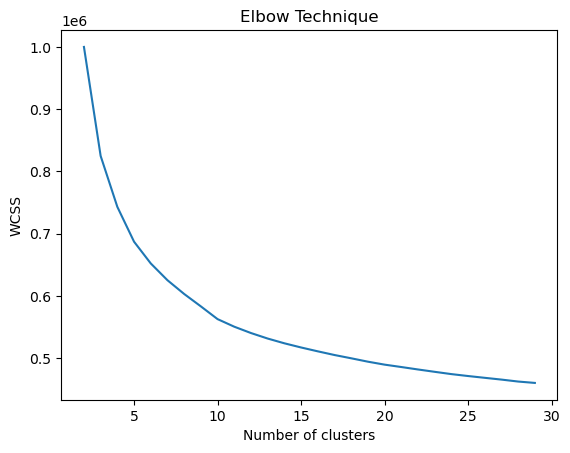

In [93]:
plt.plot(Results1_wcss.k_value,Results1_wcss.wcss)
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.title('Elbow Technique')
plt.show()

- From PCA derived resultant features dataframe, the best number of clusters by elbow technique seems to be 7 or 10, as we see sudden slope change at those values

In [100]:
# Model with optimal number of clusters 6
from sklearn.cluster import KMeans
model = KMeans(n_clusters = 10,random_state = 42)
model.fit(new_x1)
model.labels_

array([5, 5, 5, ..., 6, 6, 6], dtype=int32)

In [101]:
ss = silhouette_score(new_x1,model.labels_)
ss

0.12701962670069183

# Conclusions:
- The data given had 104 features.
- On basic check, we figured out that some columns were irrelevant, and hence filtered those.
- Now, as a second step, we inspected and filtered the columns, which had more than 90% null values.
- Also some rows had more than 50% of crucial columns missing, so those rows were also eliminated.
- The remaining data had 87 columns, of which from heat maps and correlation, around 57 features got filtered out, as they had high correlation (>70%) between them. 
- From the leftover 30 features, we did clustering. By elbow technique we figured out that 6 or 10 clusters could be the optimal number of clusters for the data.
- Infact, for the 87 features, as well as all the 30 features, we did PCA separately, and figured out that 25 is optimal number of features, that are needed to account for 95% of variance of data. That takes us to (and is in alignment with) the 30 features that we figured out manually through observing correlation. 
- Whether PCA is applied or not, the optimal number of clusters remained 6 or 10. 
- The models with their silhoutte scores are presented in the model